In [1]:
import os
import inspect
import seaborn
import matplotlib
import matplotlib.pyplot as plt
import torch
import scanpy as sc
import tqdm
import sys
import pickle
import PyComplexHeatmap as pch
import scvi
import IPython
import scipy
import pandas as pd
import numpy as np
import anndata
import gseapy
import statannotations
from statannotations.Annotator import Annotator

sc.settings.figdir=os.path.expanduser('~/WbFigures/DevFinalAnalysis')
sc._settings.settings._vector_friendly = True
plt.rcParams.update({
    'figure.dpi': 100,
    'savefig.dpi': 300,
    'font.family': 'DejaVu Sans',
    'font.sans-serif': 'DejaVuSansMono',
    'pdf.fonttype': 42
})

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

if torch.cuda.is_available():
    print("GPU is available")
    print("Number of GPUs:", torch.cuda.device_count())
    print("GPU Name:", torch.cuda.get_device_name(0))
else:
    print("GPU is not available")

sys.path.append('/home/matthew.schmitz/utils/mts-utils/')
from genomics import sc_analysis


import sys
import antipode
import antipode.antipode_model
import antipode.model_functions
import antipode.model_distributions
import antipode.model_modules
import antipode.train_utils
import antipode.plotting
import antipode.post

from antipode.post import uniqlist
plt.rc("axes.spines", top=False, right=False)


/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


GPU is not available


In [2]:
%pprint

Pretty printing has been turned OFF


In [3]:
batch_key='batch_name'
discov_key='species'
layer_key='spliced'
MDE_KEY = "X_antipode_UMAP"
leaf_key = 'level_2'
anndata.settings.allow_write_nullable_strings = True

model_tag   = '1.9.1.8.5_Dev_final_600clusters'
model_path='/home/matthew.schmitz/Matthew/models/'+model_tag
adata = sc.read_h5ad(os.path.join(model_path,'analysis_inprogress.h5ad'))
antipode_model=antipode.antipode_model.ANTIPODE.load(model_path,adata=adata,prefix='p3_',device=device)
antipode_model.save_params_to_uns()
adata=antipode_model.adata_manager.adata
pstore = adata.uns['param_store']

INFO     Generating sequential column names                                                                        


/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/pyro/params/param_store.py:334: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  s

In [4]:
adata

AnnData object with n_obs × n_vars = 1854767 × 16738
    obs: 'Class', 'G2M_score', 'S_score', 'Subclass', 'batch_name', 'female', 'general_region', 'log10_n_counts', 'new_ccl', 'new_neighborhood_extended', 'phase', 'region', 'species', 'timepoint', 'general_region_species', '_scvi_discov_ind', '_scvi_batch_ind', 'psi_0', 'psi_1', 'psi_2', 'q_score', 'level_0', 'level_1', 'level_2', 'antipode_cluster', 'kmeans', 'clean_cellname', 'dataset_name', 'doublet', 'full_cellname', 'individual', 'msregion', 'n_counts', 'n_genes', 'percent_ribo', 'singlet', 'species_dataset_name', 'anno_level_2', 'initial_class', 'ic_extended', 'abc_subclass_markercor', 'juv_subclass_markercor', 'linnarson_extended', 'lamanno_class', 'lamanno_subclass', 'lamanno_cluster', 'neighborhood', 'curated_class_label', 'new_neighborhood', 'ccl_extended', 'Neighborhood', 'Division', 'Initial_Class', 'Initial_Class_markers', 'Initial_Class_markers_level_2', 'clipped_psi_2', 'log_abs_sum_dynam', 'log10_n_genes'
    uns: 'Di

In [5]:
# aggr_means=antipode.model_functions.group_aggr_anndata(adata,[discov_key,'level_2'],layer=layer_key,normalize=True)
# aggr_sums=antipode.model_functions.group_aggr_anndata(adata,['level_2'],layer=layer_key,normalize=False,agg_func=np.sum)
# log_real_means=antipode.model_functions.safe_log_transform(aggr_means[0],aggr_sums[0].sum(-1)[np.newaxis,...,np.newaxis])
log_real_means,real_mean_levels=antipode.model_functions.get_real_leaf_means(adata,discov_key,leaf_key,layer=layer_key)
real_means=pd.DataFrame(log_real_means.mean(0),columns=adata.var.index,index=real_mean_levels[leaf_key])
real_means=real_means.loc[real_mean_levels[leaf_key],:]

100%|██████████| 380/380 [02:43<00:00,  2.33it/s]


In [6]:
def prop_zeros(x,axis=-1):
    return(np.mean(x>0.,axis=axis))
aggr_zeros=antipode.model_functions.group_aggr_anndata(adata,[discov_key,leaf_key],layer=layer_key,agg_func=prop_zeros,normalize=True)

100%|██████████| 1140/1140 [05:13<00:00,  3.64it/s]


In [7]:
pstore = adata.uns['param_store']
discov_cluster_params,cluster_params, cluster_labels,var_labels, zero_mask,(prop_taxon, prop_locs,prop_discov_di,prop_discov_dm)=antipode_model.calculate_cluster_params(flavor='numpy')
keep_clusters = np.array([x in adata.obs['level_2'].unique() for x in cluster_labels ])
cluster_labels = np.array(cluster_labels)[keep_clusters]
zero_mask = zero_mask[:,keep_clusters,:]
cluster_index = np.array([int(x) for x in cluster_labels])
zero_mask = np.nan_to_num(zero_mask,posinf=np.nan)
discov_cluster_params = discov_cluster_params[:,cluster_index,:] * zero_mask
prop_locs = prop_locs[cluster_index,:]
prop_discov_di = prop_discov_di[:,cluster_index,:] * zero_mask
prop_discov_dm = prop_discov_dm[:,cluster_index,:] * zero_mask
discov_labels=adata.obs[antipode_model.discov_key].cat.categories
latent_labels=[str(x) for x in range(pstore['discov_dc'].shape[1])]
n_clusters=antipode_model.level_sizes[-1]

/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/antipode_mixins.py:450: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  zero_mask = (adata.obs.groupby(self.discov_key)[leaf_level].value_counts().unstack().loc[:,cluster_labels]>=cluster_count_threshold).to_numpy()
/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/code/scANTIPODE/antipode/antipode_mixins.py:451: RuntimeWarning: divide by zero encountered in divide
  return discov_cluster_params,cluster_params, cluster_labels,var_labels, 1/zero_mask[...,np.newaxis],(prop_taxon, prop_locs,prop_discov_di,prop_discov_dm)


In [8]:
# discov_cluster_params = antipode.model_functions.safe_log_transform(np.exp(discov_cluster_params),aggr_sums[0].sum(-1)[np.newaxis,...,np.newaxis])

In [9]:
l1_index=sorted(adata.obs['level_1'].astype(int).unique())#list(range(antipode_model.level_sizes[-1]))#list(range(pstore['locs'].shape[0]))
l1_labels=[str(x) for x in l1_index]#adapt
l1_label_dict=dict(zip(l1_index,l1_labels))

l1_taxon=list(range(antipode_model.num_labels))[antipode_model.level_sizes[0]:(antipode_model.level_sizes[0]+antipode_model.level_sizes[1])]
l1_locs=pstore['locs'][l1_taxon]
l1_cluster_intercept=pstore['cluster_intercept'][l1_taxon]
l1_params=(l1_locs@pstore['z_decoder_weight'])+l1_cluster_intercept+np.mean(pstore['discov_constitutive_de'],0,keepdims=True)
l1_params=l1_params[l1_index,:]

In [10]:
sc.tl.dendrogram(adata,groupby='level_1',use_rep='X_antipode')
sc.tl.dendrogram(adata,groupby=leaf_key,use_rep='X_antipode')

In [11]:
centered_discov_cluster_params=discov_cluster_params-discov_cluster_params.mean(0)
centered_aggr_means=log_real_means-log_real_means.mean(0)

100%|██████████| 380/380 [00:01<00:00, 235.02it/s]


Text(0, 0.5, 'real var')

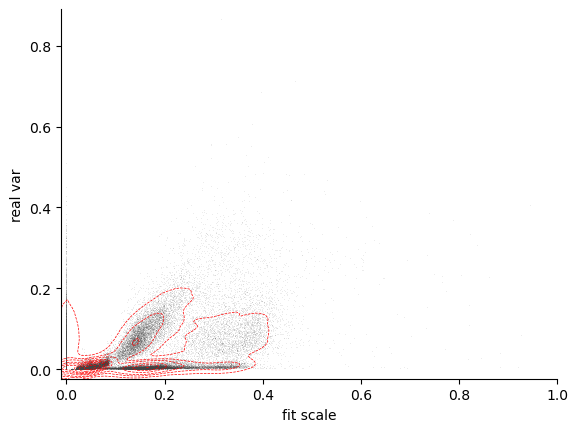

In [13]:
aggr_vars=antipode.model_functions.group_aggr_anndata(adata,[leaf_key],layer='X_antipode',obsm=True,agg_func=np.std)[0]
seaborn.scatterplot(x=pstore['scales'][cluster_index,:].flatten(),y=aggr_vars.flatten(),s=0.1,alpha=0.5,color='black')
seaborn.kdeplot(x=pstore['scales'][cluster_index,:].flatten(), y=aggr_vars.flatten(), linestyles='--', color='red', linewidths=0.5)
plt.xlim(-0.01,1.)
plt.xlabel('fit scale')
plt.ylabel('real var')


In [18]:
# kmeans_means=antipode.model_functions.group_aggr_anndata(adata,['level_2'], agg_func=np.mean,layer='X_antipode',obsm=True)[0]
# hierarchy=scipy.cluster.hierarchy.ward(kmeans_means)
# level_assignments=[scipy.cluster.hierarchy.cut_tree(hierarchy,n_clusters=x) for x in antipode_model.level_sizes]
# adata.obs['ward'] = adata.obs['level_2'].replace(dict(zip(np.array(cluster_labels)[level_assignments[2].flatten()],level_assignments[1].flatten())))

# hierarchy=scipy.cluster.hierarchy.linkage(kmeans_means,method='average',metric='cityblock')
# level_assignments=[scipy.cluster.hierarchy.cut_tree(hierarchy,n_clusters=x) for x in antipode_model.level_sizes]
# adata.obs['average'] = adata.obs['level_2'].replace(dict(zip(np.array(cluster_labels)[level_assignments[2].flatten()],level_assignments[1].flatten())))

# # Define additional methods to test
# additional_methods = {
#     'complete': {'method': 'complete', 'metric': 'cityblock'},
#     'single':   {'method': 'single',   'metric': 'cityblock'},
#     'correlation':   {'method': 'average',   'metric': 'correlation'},
#     'weighted': {'method': 'weighted', 'metric': 'cityblock'}
# }

# # Loop over the additional methods
# for name, params in additional_methods.items():
#     linkage_matrix = scipy.cluster.hierarchy.linkage(kmeans_means, method=params['method'], metric=params['metric'])
#     level_assignments = [scipy.cluster.hierarchy.cut_tree(linkage_matrix, n_clusters=x) for x in antipode_model.level_sizes]
#     adata.obs[name] = adata.obs['level_2'].replace(
#         dict(zip(np.array(cluster_labels)[level_assignments[2].flatten()],
#                  level_assignments[1].flatten()))
#     )

# # Plot the embeddings with all clustering methods as colors
# sc.pl.embedding(
#     adata,
#     basis=MDE_KEY,
#     color=['ward', 'average'] + list(additional_methods.keys()),
#     palette=sc.pl.palettes.godsnot_102,
#     legend_loc='on data'
# )


In [ ]:
seaborn.histplot(log_real_means.flatten())

In [20]:
fits=[]
for i in range(discov_cluster_params.shape[0]):
    for g in range(discov_cluster_params.shape[-1]):
        x=discov_cluster_params[i,:,g]
        y=log_real_means[i,:,g]
        mask = ~np.isnan(x) & ~np.isnan(y)
        x=x[mask]
        y=y[mask]
        fits.append(scipy.stats.stats.spearmanr(x,y).statistic)


/scratch/fast/1449202/ipykernel_2299875/402612874.py:9: DeprecationWarning: Please import `spearmanr` from the `scipy.stats` namespace; the `scipy.stats.stats` namespace is deprecated and will be removed in SciPy 2.0.0.
  fits.append(scipy.stats.stats.spearmanr(x,y).statistic)


0.519565041375287


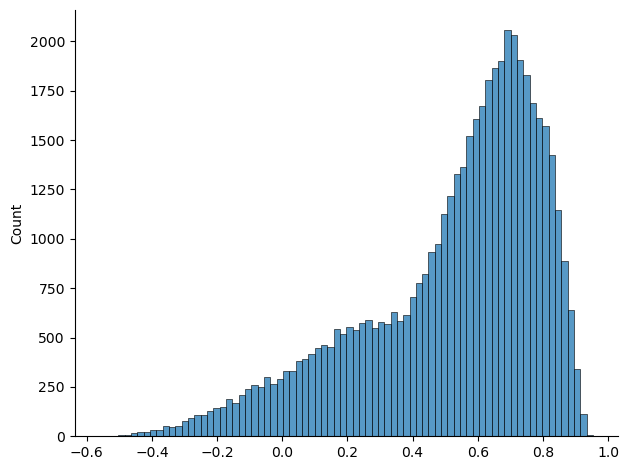

In [21]:
print(np.mean(np.nan_to_num(fits)))
seaborn.histplot(fits)
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'recons_vs_real_spearman_corr.svg'), format='svg')

<Axes: >

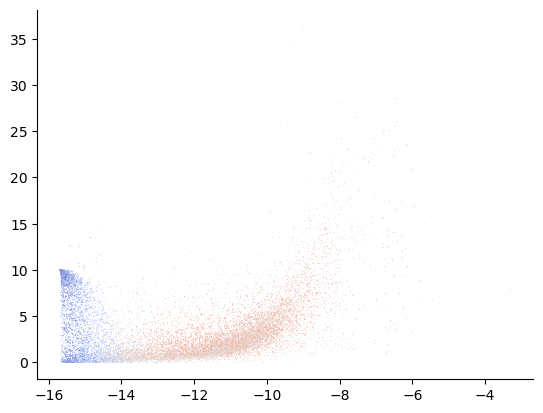

In [22]:
norm = plt.Normalize(-1, 1)

# Create a colormap object
cmap = plt.cm.coolwarm

# Map 'fits' values to the colormap
colors = cmap(np.array(fits[:adata.uns['param_store']['s_inverse_dispersion'].shape[0]]))

seaborn.scatterplot(x=log_real_means.mean(0).mean(0),y=adata.uns['param_store']['s_inverse_dispersion'],color=colors,s=.3)

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/IPython/core/events.py:82: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


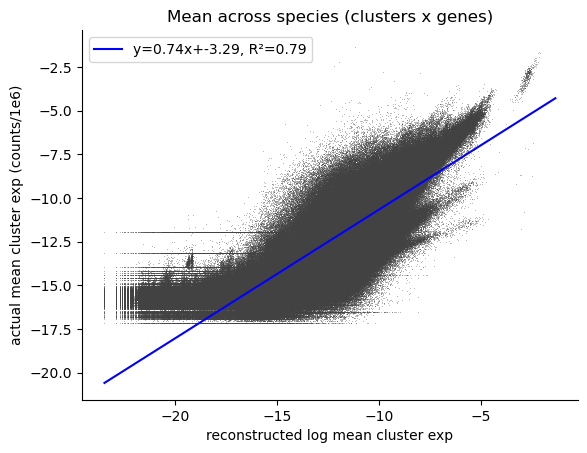

In [25]:
x=cluster_params.flatten()
y=log_real_means.mean(0).flatten()
mask = ~np.isnan(x) & ~np.isnan(y)
x=x[mask]
y=y[mask]
randinds=np.random.choice(np.array(list(range(len(y)))),size=200000,replace=False)

seaborn.scatterplot(x=x,y=y,s=0.2,color='black')
#seaborn.kdeplot(x=cluster_params.flatten()[randinds],y=log_real_means.mean(0).flatten()[randinds],linestyles='--',color='red', linewidths=0.5)
plt.xlabel('reconstructed log mean cluster exp')
plt.ylabel('actual mean cluster exp (counts/1e6)')

# Calculate the regression parameters
slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(x,y)

# Plot the regression line
x_values = np.linspace(np.min(x), np.max(y), 100)
plt.plot(x_values, slope * x_values + intercept, color='blue', label=f'y={slope:.2f}x+{intercept:.2f}, R²={r_value**2:.2f}')
plt.title('Mean across species (clusters x genes)')
# Add legend
plt.legend()


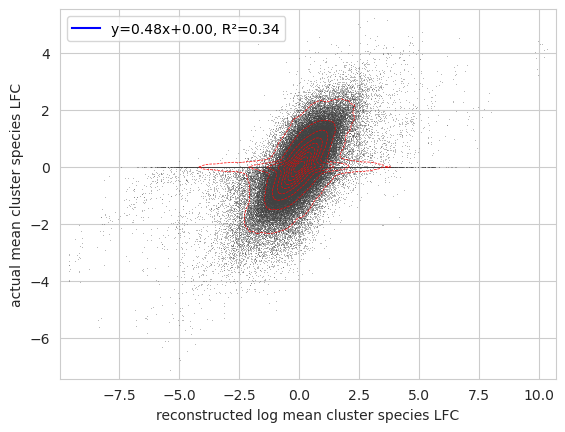

In [26]:
x=centered_discov_cluster_params.flatten()
y=centered_aggr_means.flatten()
mask = ~np.isnan(x) & ~np.isnan(y)
x=x[mask]
y=y[mask]
randinds=np.random.choice(np.array(list(range(len(x)))),size=200000,replace=False)

with seaborn.axes_style("whitegrid"):
    seaborn.scatterplot(x=x[randinds],y=y[randinds],s=0.2,color='black')
    seaborn.kdeplot(x=x[randinds],y=y[randinds],color='red',linestyles='--', linewidths=0.5)
    plt.xlabel('reconstructed log mean cluster species LFC')
    plt.ylabel('actual mean cluster species LFC')

# Calculate the regression parameters
slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(x,y)

# Plot the regression line
x_values = np.linspace(np.min(centered_discov_cluster_params.flatten()[randinds]), np.max(centered_discov_cluster_params.flatten()[randinds]), 100)
plt.plot(x_values, slope * x_values + intercept, color='blue', label=f'y={slope:.2f}x+{intercept:.2f}, R²={r_value**2:.2f}')

# Add legend
plt.legend()


/scratch/fast/1449202/ipykernel_2299875/2434021067.py:9: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


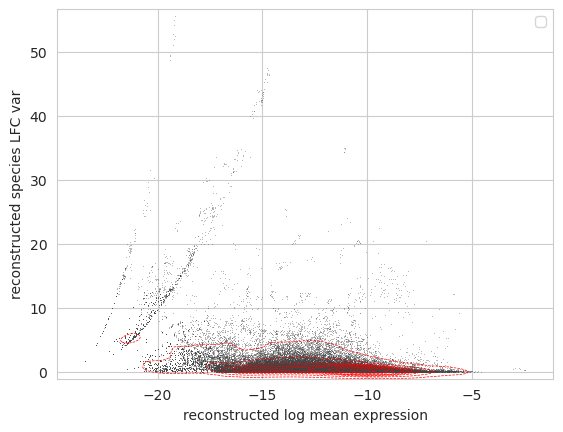

In [27]:
randinds=np.random.choice(np.array(list(range(cluster_params.flatten().shape[0]))),size=100000,replace=False)
with seaborn.axes_style("whitegrid"):
    seaborn.scatterplot(x=cluster_params.flatten()[randinds],y=centered_discov_cluster_params.var(0).flatten()[randinds],s=0.2,color='black')
    seaborn.kdeplot(x=cluster_params.flatten()[randinds],y=centered_discov_cluster_params.var(0).flatten()[randinds],color='red',linestyles='--', linewidths=0.5)
    plt.xlabel('reconstructed log mean expression')
    plt.ylabel('reconstructed species LFC var')

# Add legend
plt.legend()


In [28]:
def melt_param_3d(X,discov_labels,cluster_labels,var_labels):
    dfs=[]
    for i in range(len(discov_labels)):
        for j in range(len(cluster_labels)):
            df=pd.DataFrame(X[i,j,:],columns=['value'])
            df['discov']=discov_labels[i]
            df['cluster']=cluster_labels[j]
            df['var']=var_labels
            dfs.append(df)
    return(pd.concat(dfs,axis=0))

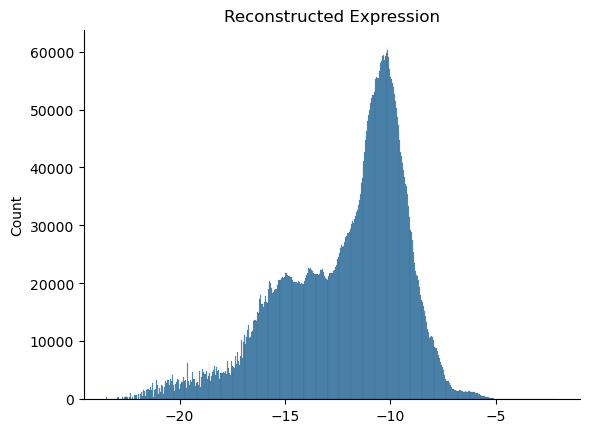

In [29]:
seaborn.histplot(cluster_params.flatten())
plt.title('Reconstructed Expression')
plt.show()


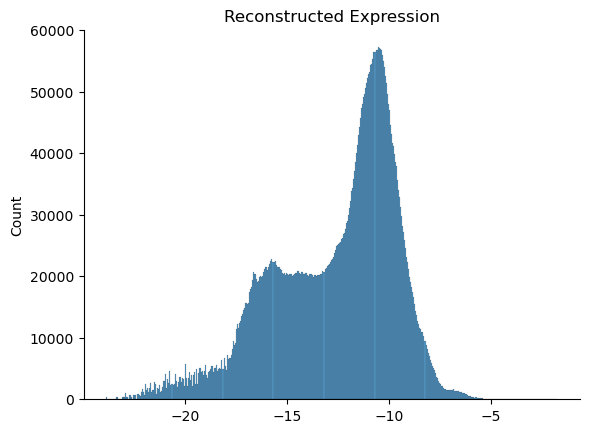

In [30]:
seaborn.histplot(discov_cluster_params.mean(0).flatten())
plt.title('Reconstructed Expression')
plt.show()

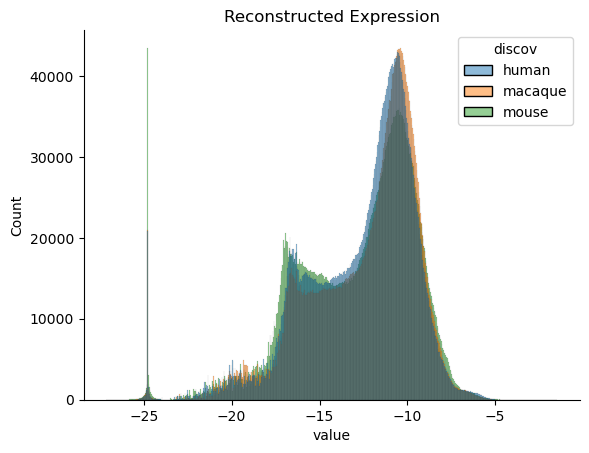

/scratch/fast/1449202/ipykernel_2299875/2709062082.py:8: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/scratch/fast/1449202/ipykernel_2299875/2709062082.py:9: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig(os.path.join(sc.settings.figdir, 'recons_mean_ecdf.svg'), format='svg')
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


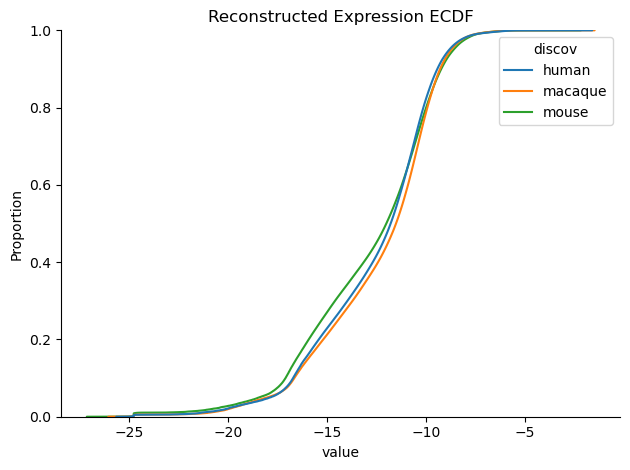

In [31]:
melted_reconstruction=melt_param_3d(discov_cluster_params,discov_labels,cluster_labels,var_labels)
melted_reconstruction = melted_reconstruction.loc[~np.isnan(melted_reconstruction['value']),:]
seaborn.histplot(data=melted_reconstruction,x='value',hue='discov')
plt.title('Reconstructed Expression')
plt.show()
seaborn.ecdfplot(data=melted_reconstruction,x='value',hue='discov')
plt.title('Reconstructed Expression ECDF')
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'recons_mean_ecdf.svg'), format='svg')
plt.show()


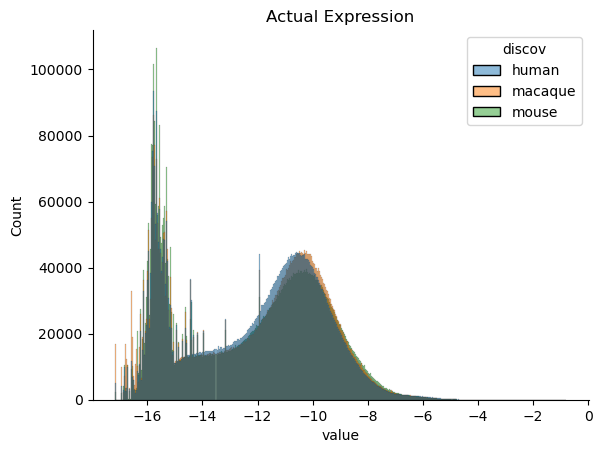

/scratch/fast/1449202/ipykernel_2299875/4069920265.py:7: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/scratch/fast/1449202/ipykernel_2299875/4069920265.py:8: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig(os.path.join(sc.settings.figdir, 'actual_mean_ecdf.svg'), format='svg')
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


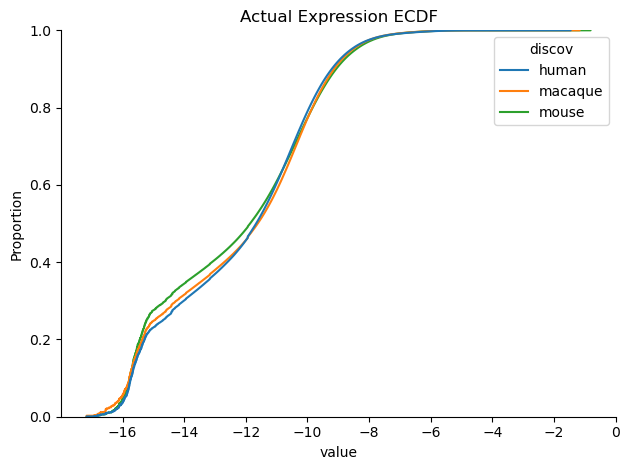

In [32]:
melted_means=melt_param_3d(log_real_means,discov_labels,cluster_labels,var_labels)
seaborn.histplot(data=melted_means,x='value',hue='discov')
plt.title('Actual Expression')
plt.show()
seaborn.ecdfplot(data=melted_means,x='value',hue='discov')
plt.title('Actual Expression ECDF')
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'actual_mean_ecdf.svg'), format='svg')
plt.show()

# Params

In [ ]:
sc_analysis.create_heatmap(pd.DataFrame(sc_analysis.corr2_coeff(pstore['locs'],pstore['locs'])),cmap='coolwarm')

In [ ]:
sc_analysis.create_heatmap(pd.DataFrame(sc_analysis.corr2_coeff(pstore['discov_di'][0],pstore['discov_di'][0])),cmap='coolwarm')

In [ ]:
sc_analysis.create_heatmap(pd.DataFrame(sc_analysis.corr2_coeff(pstore['discov_dm'][0],pstore['discov_dm'][0])),cmap='coolwarm')

In [ ]:
sc_analysis.create_heatmap(pd.DataFrame(sc_analysis.corr2_coeff(pstore['discov_dc'][0],pstore['discov_dc'][0])),cmap='coolwarm')

In [ ]:
sc_analysis.create_heatmap(pd.DataFrame(sc_analysis.corr2_coeff(pstore['z_decoder_weight'],pstore['z_decoder_weight'])),cmap='coolwarm')

# Markerness and GEX Evolution

Genes that are specifically expressed in only one state/initial class are more differentially expressed across species, however genes that are specifically off in a state/class are not more likely to be DE, and less specific markers are also not more likely to be DE

In [38]:
clipped_expr_df = pd.DataFrame(np.clip(discov_cluster_params,a_min=-20,a_max=1e10).mean(0),columns=adata.var.index,index=cluster_labels)

## Specific markers

cluster - max

In [39]:
window_size=2001
def moving_average_values(x,y,window_size=1001):
    moving_average = antipode.plotting.moving_average(y[np.argsort(x)],window_size)
    return(np.sort(x[int(window_size/2):-int(window_size/2)]),moving_average)
    
def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

def select_marker_genes(marker_df, expr_df, threshold, marker=True, other_quantile=0.95):
    """
    Select marker or antimarker genes for each cluster.

    For marker==True (markers):
      - marker_df should be computed with a high quantile (e.g. 0.95 or 0.99).
      - For each cluster, genes are sorted in descending order (largest difference first).
      - The function returns the first gene whose expression in the cluster exceeds `threshold`.
      - If none pass, the top-ranked gene is returned.

    For marker==False (antimarkers):
      - marker_df should be computed with a low quantile (e.g. 0.1).
      - Genes are sorted in ascending order (lowest difference first).
      - For each candidate gene, the expression in all other clusters is examined.
      - If `other_threshold` is provided, the gene is chosen only if the specified quantile
        (default 0.95) of its expression in the other clusters exceeds `other_threshold`.
      - If no gene meets this filter, the top candidate (i.e. the gene with the minimum score)
        is returned.
    
    :param marker_df: DataFrame from get_quantile_markers (clusters as rows, genes as columns).
    :param expr_df: DataFrame of the original expression values (clusters as rows, genes as columns).
    :param threshold: In 'marker' mode, the minimum expression required in the target cluster.
                      In 'antimarker' mode, not used.
    :param marker: Boolean to use markers or antimarker strategy
    :param other_quantile: In 'antimarker' mode, the quantile of the non-target clusters’ expression to consider.
    :return: Dictionary mapping cluster -> selected gene.
    """
    selected_markers = {}
    clusters = marker_df.index

    for cluster in clusters:
        if marker:
            # For markers, higher score is better.
            sorted_genes = marker_df.loc[cluster].sort_values(ascending=False)
            top_gene = sorted_genes.index[0]
            chosen_gene = None
            for gene in sorted_genes.index:
                if expr_df.loc[cluster, gene] > threshold:
                    chosen_gene = gene
                    break
            selected_markers[cluster] = chosen_gene if chosen_gene is not None else top_gene

        else:
            # For antimarkers, lower score is better.
            sorted_genes = marker_df.loc[cluster].sort_values(ascending=True)
            top_gene = sorted_genes.index[0]
            chosen_gene = None
            # Identify the other clusters
            other_clusters = expr_df.index.difference([cluster])
            for gene in sorted_genes.index:
                other_expr = expr_df.loc[other_clusters, gene]
                # If no threshold is provided, pick the top candidate.
                # Otherwise, require that a high quantile of expression in others exceeds the threshold.
                if (threshold is None) or (np.quantile(other_expr, other_quantile) > threshold):
                    chosen_gene = gene
                    break
            selected_markers[cluster] = chosen_gene if chosen_gene is not None else top_gene

    return selected_markers

def get_quantile_markers(df,q=0.95):
    """
    Get the markers for the rows of a dataframe.

    :param df: GEX means where rows are categories and columns are named features.
    :param q: Quantile of mean to subtract.
    :return: A matrix which has the difference of each gene in each cluster vs the quantile value in all other clusters.
    """
    df_array=df.to_numpy()
    coefs=[]
    for i in tqdm.tqdm(range(df.shape[0])):
        others=list(set(list(range(df.shape[0])))-set([i]))
        coefs.append((df_array[i:(i+1),:]-np.nanquantile(df_array[others,:],q,axis=0)))#/(cluster_params.std(0)+cluster_params.std(0).mean()))
    coefs=np.concatenate(coefs,axis=0)
    marker_df=pd.DataFrame(coefs,index=df.index,columns=df.columns)
    return(marker_df)

def get_conserved_quantile_markers(exprs,index,columns,q=0.95,antimarker=False):
    """
    Get the conserved markers for axis 1 of mean expression tensor.

    :param df: GEX means where rows are categories and columns are named features.
    :param q: Quantile of mean to subtract.
    :return: A matrix which has the difference of each gene in each cluster vs the quantile value in all other clusters.
    """
    direction_operation = np.max if antimarker else np.min
    coefs=[]
    for i in tqdm.tqdm(range(exprs.shape[1])):
        others=list(set(list(range(exprs.shape[1])))-set([i]))
        diff_from_quantile = exprs[:,i,:]-np.nanquantile(exprs[:,others,:],q,axis=1)
        coefs.append(direction_operation(diff_from_quantile,axis=0))#/(cluster_params.std(0)+cluster_params.std(0).mean()))
    coefs_cat=np.stack(coefs,axis=0)
    marker_df=pd.DataFrame(coefs_cat,index=index,columns=columns)
    return(marker_df)


# Conserved Specific

In [ ]:
quantile = 0.98
coefdf = antipode.post.get_conserved_quantile_markers(discov_cluster_params,columns=adata.var.index,index=cluster_labels, q=quantile,antimarker=False)
selected_markers = antipode.post.select_marker_genes(
    coefdf, clipped_expr_df, marker=True,
    threshold=np.log(5/1e6))
marker_gene_order=uniqlist([selected_markers[x] for x in adata.uns['dendrogram_level_2']['categories_ordered']])

cx=coefdf.to_numpy().flatten()
cy=np.absolute(centered_discov_cluster_params).mean(0).flatten()
seaborn.scatterplot(x=cx,y=cy,s=0.2)
ma_x,ma_y=antipode.plotting.moving_average_values(cx,cy,window_size)
plt.plot(ma_x,ma_y, color='red',linewidth=0.3, label=f'Moving Average ({window_size} points)')
plt.axhline(y=ma_y.mean(),color='black',linestyle=':',linewidth=0.8)
plt.xlabel('specificity (LFC vs '+str(quantile)+' quantile other clusters)')
plt.ylabel('max DE LFC in cluster')
plt.title('Specific Markers')
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'conserved_specific_de_meanscatter.svg'), format='svg')
plt.show()

sc.pl.dotplot(adata,groupby=leaf_key,var_names=marker_gene_order,dendrogram='dendrogram_level_2',standard_scale='var',use_raw=False,cmap='coolwarm',save='conserved_specific.svg')

In [41]:
adata.uns['dendrogram_level_2']['categories_ordered']

[542, 131, 454, 143, 366, 212, 534, 598, 39, 572, 171, 469, 401, 193, 475, 492, 586, 286, 164, 248, 517, 182, 457, 87, 70, 407, 79, 374, 323, 413, 207, 64, 347, 590, 26, 498, 519, 329, 301, 442, 9, 523, 7, 570, 114, 546, 252, 148, 178, 221, 441, 80, 153, 55, 552, 4, 463, 53, 51, 327, 176, 233, 222, 338, 14, 452, 158, 536, 88, 543, 140, 165, 500, 108, 583, 300, 251, 50, 373, 456, 589, 299, 535, 107, 375, 130, 241, 183, 224, 505, 95, 399, 594, 336, 573, 59, 124, 127, 362, 415, 65, 289, 275, 266, 195, 382, 389, 60, 384, 129, 135, 112, 18, 121, 380, 321, 20, 432, 470, 215, 563, 421, 201, 141, 349, 157, 12, 467, 509, 538, 119, 574, 101, 204, 309, 433, 330, 271, 256, 155, 540, 223, 126, 46, 67, 568, 284, 294, 351, 150, 368, 100, 206, 220, 355, 288, 328, 94, 69, 557, 312, 13, 496, 24, 190, 154, 575, 202, 571, 44, 553, 118, 259, 132, 340, 370, 292, 486, 138, 174, 83, 450, 198, 520, 592, 354, 122, 371, 120, 339, 405, 211, 344, 298, 254, 92, 306, 372, 416, 539, 196, 187, 501, 357, 427, 15, 68, 4

In [42]:
marker_gene_order

['PVT1', 'SCFD2', 'DBX2', 'EGFR', 'OLIG1', 'TLCD1', 'SPRY2', 'GSTCD', 'INKA2', 'IGFBP2', 'CLDN5', 'SLBP', 'SNRPA1', 'PDAP1', 'CCNB2', 'SEMA7A', 'METTL9', 'ARL6IP1', 'UBE2S', 'TRAPPC2', 'PXMP2', 'RFC4', 'DBNDD1', 'HS3ST4', 'NEFH', 'SNCB', 'ADAMTS5', 'C12orf73', 'NAP1L5', 'RAB9B', 'DTD1', 'CNRIP1', 'HAP1', 'SST', 'NPY', 'H1-5', 'MCM4', 'EPHX2', 'FABP7', 'GLI3', 'OTP', 'PITX2', 'ROBO3', 'EPB41', 'PET100', 'VIPAS39', 'PCIF1', 'SCRT2', 'LHX5', 'TAL2', 'C14orf93', 'CHRNA5', 'ENOX2', 'GAS2', 'LHX2', 'PANTR1', 'TIMM8B', 'KIF26B', 'COX7A2L', 'BCL2L1', 'NECAB3', 'CDCA7', 'OLA1', 'PFN2', 'PAX6', 'RPS19', 'APEX1', 'ANGPTL1', 'MYCN', 'GSX1', 'GADD45G', 'MAGEL2', 'DLL3', 'MAP3K1', 'CCNE2', 'TIGAR', 'NEUROG1', 'DLEU7', 'NEUROG2', 'TBPL1', 'ISL1', 'BEND5', 'SIX3', 'MPPED2', 'HNRNPDL', 'BCL9', 'VPS72', 'FRAT1', 'EIF3H', 'TRIR', 'SGCD', 'RIDA', 'PENK', 'SOX5', 'ZNF205', 'DLX6-AS1', 'CRYZL1', 'RPS15A', 'H1-1', 'RSPO2', 'HAS2', 'WNT3', 'DCTPP1', 'BTF3', 'MSH6', 'FGF5', 'CHL1', 'SERINC1', 'AGAP2', 'ERBB3',

In [43]:
import matplotlib.pyplot as plt
from matplotlib.patches import Wedge
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize

def pie_dotplot(means_list, proportions_list, column_names, row_names,
                colormaps=None, max_radius=0.4, figsize=(10, 8),
                scale_by='column', mean_vmin=None, mean_vmax=None,fontsize_mul=1.5):
    """
    Plots a grid of pie charts where:
      - Each cell is drawn as a pie chart with equal angular slices.
      - The outer radius of each slice is scaled by its proportion value.
      - The color of each slice is determined by the mean expression value,
        normalized either per column (gene), per row (cluster), or using global
        values per slice (if scale_by is None).
    
    In addition, a legend is added to the right of the plot for each slice
    showing its colormap with the global min and max values.
    
    Parameters:
    -----------
    means_list : list of np.ndarray
        List of matrices (shape: [n_clusters, n_genes]) containing mean expression values.
    proportions_list : list of np.ndarray
        List of matrices (shape: [n_clusters, n_genes]) containing proportion values.
    column_names : list of str
        Names for genes to label the X-axis.
    row_names : list of str
        Names for clusters to label the Y-axis.
    colormaps : list of str, optional
        List of colormap names (one per slice). Defaults to a set of common colormaps.
    max_radius : float, optional
        Maximum radius for a full (proportion = 1) slice.
    figsize : tuple, optional
        Figure size.
    scale_by : str or None, optional
        If "column", each gene column is normalized to [0, 1] using the min and max
        across all clusters and slices. If "row", each cluster row is normalized.
        If None, each slice is normalized using its own global min/max (computed from means_list).
    mean_vmin, mean_vmax : list of floats, optional
        When scale_by is None, these can be provided for each slice; otherwise they are computed.
    
    Returns:
    --------
    fig, ax : matplotlib Figure and Axes
    """
    if len(means_list) != len(proportions_list):
        raise ValueError("means_list and proportions_list must have the same length")
    n_slices = len(means_list)
    n_clusters, n_genes = means_list[0].shape

    # Set default colormaps if not provided.
    if colormaps is None:
        default_cmaps = ['Blues', 'Oranges', 'Greens', 'Purples', 'Reds', 'Greys']
        if n_slices > len(default_cmaps):
            colormaps = [default_cmaps[i % len(default_cmaps)] for i in range(n_slices)]
        else:
            colormaps = default_cmaps[:n_slices]

    # For legend purposes, compute global min/max for each slice.
    global_vmin = []
    global_vmax = []
    for k in range(n_slices):
        global_vmin.append(np.min(means_list[k]))
        global_vmax.append(np.max(means_list[k]))

    # Precompute normalization ranges for cell-level scaling.
    if scale_by is None:
        if mean_vmin is None:
            mean_vmin = [np.min(m) for m in means_list]
        if mean_vmax is None:
            mean_vmax = [np.max(m) for m in means_list]
    elif scale_by == 'column':
        # For each gene (column), compute the min and max over all clusters and slices.
        col_vmin = np.empty(n_genes)
        col_vmax = np.empty(n_genes)
        for j in range(n_genes):
            col_vmin[j] = min(np.min(matrix[:, j]) for matrix in means_list)
            col_vmax[j] = max(np.max(matrix[:, j]) for matrix in means_list)
    elif scale_by == 'row':
        # For each cluster (row), compute the min and max over all genes and slices.
        row_vmin = np.empty(n_clusters)
        row_vmax = np.empty(n_clusters)
        for i in range(n_clusters):
            row_vmin[i] = min(np.min(matrix[i, :]) for matrix in means_list)
            row_vmax[i] = max(np.max(matrix[i, :]) for matrix in means_list)
    else:
        raise ValueError("scale_by must be either 'column', 'row', or None.")

    fig, ax = plt.subplots(figsize=figsize)

    # Adjust font sizes based on number of genes/clusters.
    x_fontsize = max(6, min(10, 300 / n_genes))
    y_fontsize = max(6, min(10, 300 / n_clusters))
    ax.tick_params(axis='x', labelsize=x_fontsize*fontsize_mul)
    ax.tick_params(axis='y', labelsize=y_fontsize*fontsize_mul)

    # Loop over each grid cell.
    for i in range(n_clusters):
        for j in range(n_genes):
            center = (j, i)
            for k in range(n_slices):
                mean_val = means_list[k][i, j]
                prop_val = proportions_list[k][i, j]
                # Define angular range for the slice.
                theta1 = 360 * k / n_slices + 30
                theta2 = 360 * (k + 1) / n_slices + 30
                radius = prop_val * max_radius

                # Determine normalization range.
                if scale_by == 'column':
                    vmin = col_vmin[j]
                    vmax = col_vmax[j]
                elif scale_by == 'row':
                    vmin = row_vmin[i]
                    vmax = row_vmax[i]
                else:
                    vmin = mean_vmin[k]
                    vmax = mean_vmax[k]

                if vmax > vmin:
                    norm_val = (mean_val - vmin) / (vmax - vmin)
                else:
                    norm_val = 0.5

                cmap = plt.get_cmap(colormaps[k])
                color = cmap(norm_val)
                wedge = Wedge(center, radius, theta1, theta2, facecolor=color, edgecolor='none', linewidth=0)
                ax.add_patch(wedge)

    ax.set_xlim(-0.5, n_genes - 0.5)
    ax.set_ylim(-0.5, n_clusters - 0.5)
    ax.set_xticks(range(n_genes))
    ax.set_xticklabels(column_names, rotation=90)
    ax.set_yticks(range(n_clusters))
    ax.set_yticklabels(row_names)
    ax.set_aspect('equal')

    # Adjust the main axis to leave space on the right for colorbars.
    plt.tight_layout(rect=[0, 0, 0.85, 1])

    # Create a colorbar for each slice (colormap).
    # We'll stack them vertically on the right side.
    n_colorbars = n_slices
    cbar_width = 0.03
    cbar_gap = 0.02
    total_height = 0.9  # relative to figure height
    cbar_height = (total_height - (n_colorbars - 1) * cbar_gap) / n_colorbars
    # Starting bottom position.
    bottom_start = 0.05

    for k in range(n_slices):
        # For legend, we use the global min/max of each slice.
        norm = Normalize(vmin=global_vmin[k], vmax=global_vmax[k])
        sm = ScalarMappable(norm=norm, cmap=plt.get_cmap(colormaps[k]))
        sm.set_array([])

        # Compute position for this colorbar.
        cbar_bottom = bottom_start + (n_colorbars - k - 1) * (cbar_height + cbar_gap)
        cax = fig.add_axes([0.87, cbar_bottom, cbar_width, cbar_height])
        cbar = fig.colorbar(sm, cax=cax)
        cbar.ax.tick_params(labelsize=8)
        cbar.set_label(f'Slice {k+1}\n({colormaps[k]})', fontsize=8)

    return fig, ax


In [44]:
len(adata.uns['dendrogram_level_2']['categories_idx_ordered'])

380

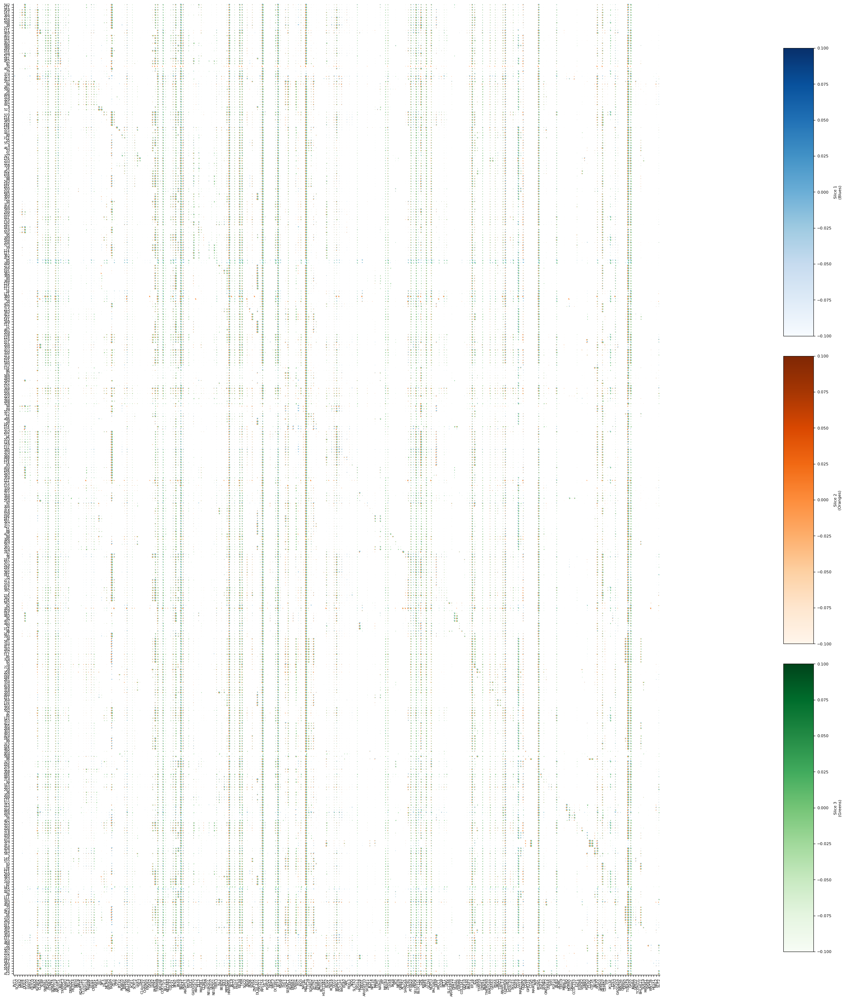

In [45]:
gene_order = np.array([np.where(var_labels == x) for x in marker_gene_order]).flatten()
cat_order = list(reversed(adata.uns['dendrogram_level_2']['categories_idx_ordered']))
pie_dotplot([discov_cluster_params[i,:,gene_order][:,cat_order].T for i in range(discov_cluster_params.shape[0])],
            [aggr_zeros[0][i,:,gene_order][:,cat_order].T for i in range(aggr_zeros[0].shape[0])], 
            marker_gene_order, list(reversed(adata.uns['dendrogram_level_2']['categories_ordered'])),
            scale_by='column', max_radius=0.4, figsize=(28, 28),fontsize_mul=1.1)
plt.savefig(os.path.join(sc.settings.figdir, 'triple_conserved_marker_dots.svg'), format='svg')
plt.show()

In [46]:
coefdf.to_csv(os.path.join(sc.settings.figdir,'dev_level2_99quant_markers.tsv'),sep='\t')

In [47]:
mat = np.exp(clipped_expr_df.T)
row_max = mat.max(axis=1)
# Avoid division by zero
mat_norm = mat.div(row_max, axis=0)
# Compute Tau: sum(1 - norm) / (n_celltypes - 1)
tau = (1 - mat_norm).sum(axis=1) / (mat.shape[1] - 1)
# Replace any NaNs with 0
tau = tau.fillna(0)


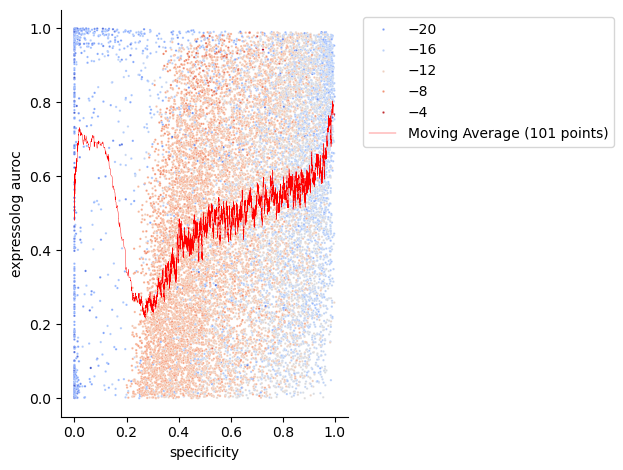

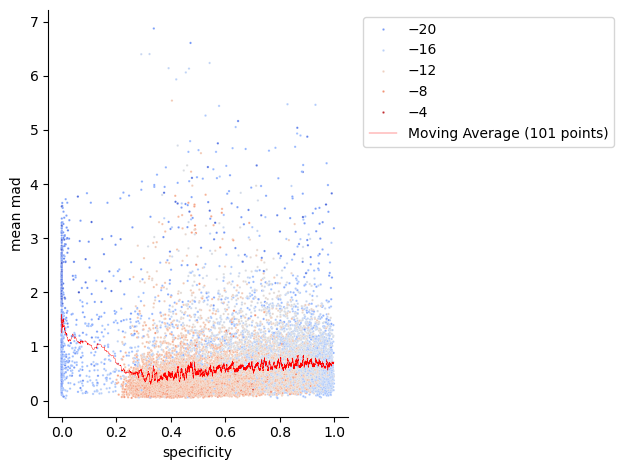

In [48]:
def compute_expressolog(species_cluster_means, species_names, gene_names,transform = 'mean'):
    """
    Compute expressolog metrics (per‐gene, per species‐pair) from a
    numpy array of shape (n_species, n_cell_types, n_genes).

    Returns a DataFrame with columns:
      gene, species1, species2, sp1_expr_stat, sp2_expr_stat, expr_cor, sp_order
    """
    S, C, G = species_cluster_means.shape

    # 1) per‐species per‐gene std dev
    sp_std = species_cluster_means.std(axis=1)        # shape (S, G)

    # 2) per‐pair per‐gene correlation
    #    corr[i,j,g] = corr between species i and j across cell types for gene g
    corr = np.empty((S, S, G), dtype=float)
    for i in range(S):
        xi = species_cluster_means[i]                # shape (C, G)
        xi_mean = xi.mean(axis=0)
        xi_centered = xi - xi_mean                   # shape (C, G)
        xi_std = sp_std[i]                           # shape (G,)
        for j in range(S):
            xj = species_cluster_means[j]
            xj_centered = xj - xj.mean(axis=0)
            xj_std = sp_std[j]
            # biased covariance across cell types
            cov = (xi_centered * xj_centered).mean(axis=0)
            corr[i, j] = cov / (xi_std * xj_std)

    # 3) flatten
    rows = []
    for i in range(S):
        for j in range(S):
            if i == j:
                continue
            order = 1 if i < j else 2
            rows.append(pd.DataFrame({
                'gene':         gene_names,
                'species1':     species_names[i],
                'species2':     species_names[j],
                'sp1_expr_stat': sp_std[i],
                'sp2_expr_stat': sp_std[j],
                'expr_cor':      corr[i, j],
                'sp_order':      order
            }))

    expressolog = pd.concat(rows, ignore_index=True)
    expressolog[f'{transform}_cor'] = expressolog.groupby('gene')['expr_cor'].transform(transform)

    # 4) sort descending by that {transform}
    expressolog = expressolog.sort_values(f'{transform}_cor', ascending=False)
    
    # 5) dense‐rank the genes by {transform}_cor (1,2,3,… with no gaps)
    expressolog['rank'] = expressolog[f'{transform}_cor'] \
                   .rank(method='dense', ascending=False) \
                   .astype(int)
    
    # 6) compute auroc = rank / (number of distinct genes)
    n_genes = expressolog['gene'].nunique()
    expressolog['auroc'] = 1 - (expressolog['rank'] / n_genes)
    
    expressolog = expressolog.reset_index(drop=True)
    return expressolog

not_na = discov_cluster_params[:,~np.isnan(discov_cluster_params.var(0).sum(1)),:]
mat = pd.DataFrame(np.exp(not_na).mean(0),index=cluster_labels[~np.isnan(discov_cluster_params.var(0).sum(1))],columns=var_labels).T#clipped_expr_df.T)
row_max = mat.max(axis=1)
# Avoid division by zero
mat_norm = mat.div(row_max, axis=0)
# Compute Tau: sum(1 - norm) / (n_celltypes - 1)
tau = (1 - mat_norm).sum(axis=1) / (mat.shape[1] - 1)
# Replace any NaNs with 0
tau = tau.fillna(0)

# tau = np.log((mat.T/(mat).sum(axis=1)).T.max(1))
# Replace any NaNs with 0
# tau = tau.fillna(0)


expressolog = compute_expressolog(not_na,discov_labels,var_labels)

mean_corrs = expressolog.groupby('gene')['auroc'].mean()
# mean_corrs = expressolog.groupby('gene')['expr_cor'].mean()
cx = np.array(tau)
cy = np.array(mean_corrs[tau.index])
ma_x,ma_y=antipode.plotting.moving_average_values(cx,cy,101)
seaborn.scatterplot(x=cx,y=cy,s=2.8,hue=not_na.mean(0).mean(0),palette='coolwarm')#
# seaborn.kdeplot(x=cx,y=cy,s=2.8,color='black',linestyles='--', linewidths=0.5,alpha=0.7)
plt.plot(ma_x,ma_y, color='red',linewidth=0.3, label=f'Moving Average ({101} points)')
seaborn.despine()
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xlabel('specificity')
plt.ylabel('expressolog auroc')
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'fit_tau_vs_expressolog.png'), format='png')
plt.show()

# seaborn.scatterplot(x=tau,y=mean_corrs,s=0.8,hue=not_na.mean(0).mean(0),palette='coolwarm')
# plt.show()
cy = np.abs(not_na-not_na.mean(0)).mean(0).mean(0)
ma_x,ma_y=antipode.plotting.moving_average_values(cx,cy,101)
seaborn.scatterplot(x=cx,y=cy,s=2.8,hue=not_na.mean(0).mean(0),palette='coolwarm')#
# seaborn.kdeplot(x=cx,y=cy,s=2.8,color='black',linestyles='--', linewidths=0.5,alpha=0.7)
plt.plot(ma_x,ma_y, color='red',linewidth=0.3, label=f'Moving Average ({101} points)')
seaborn.despine()
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xlabel('specificity')
plt.ylabel('mean mad')
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'fit_tau_vs_meanvar.png'), format='png')
plt.show()


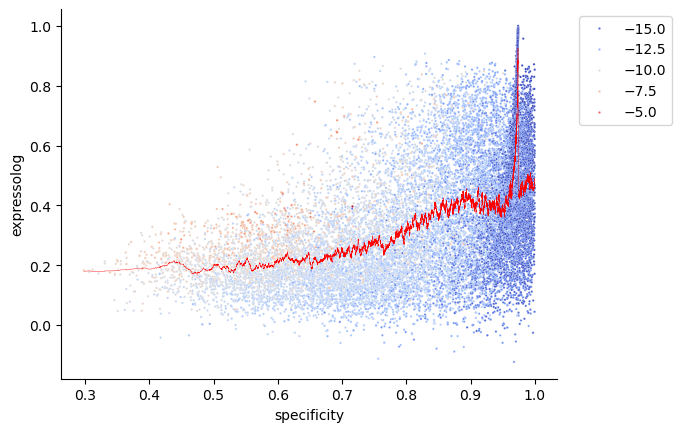

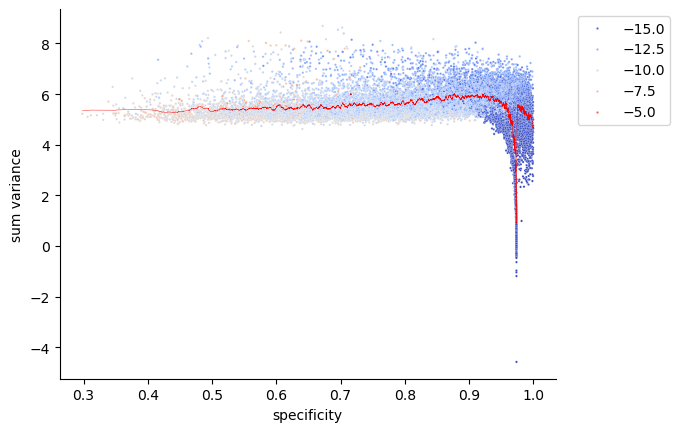

In [49]:
not_na = log_real_means[:,~np.isnan(log_real_means.var(0).sum(1)),:]
mat = pd.DataFrame(np.exp(not_na).mean(0),index=cluster_labels[~np.isnan(log_real_means.var(0).sum(1))],columns=var_labels).T#clipped_expr_df.T)
row_max = mat.max(axis=1)
# Avoid division by zero
mat_norm = mat.div(row_max, axis=0)
# Compute Tau: sum(1 - norm) / (n_celltypes - 1)
tau = (1 - mat_norm).sum(axis=1) / (mat.shape[1] - 1)
# Replace any NaNs with 0
tau = tau.fillna(0)


expressolog = compute_expressolog(not_na,discov_labels,var_labels)
mean_corrs = expressolog.groupby('gene')['expr_cor'].mean()
cx = np.array(tau)
cy = np.array(mean_corrs[tau.index])
ma_x,ma_y=antipode.plotting.moving_average_values(cx,cy,101)
seaborn.scatterplot(x=cx,y=cy,s=2.8,hue=not_na.mean(0).mean(0),palette='coolwarm')#
plt.plot(ma_x,ma_y, color='red',linewidth=0.3)
seaborn.despine()
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1))
plt.xlabel('specificity')
plt.ylabel('expressolog')
# plt.savefig(os.path.join(sc.settings.figdir, 'real_tau_vs_expressolog.svg'), format='svg')
plt.show()

# seaborn.scatterplot(x=tau,y=mean_corrs,s=0.8,hue=not_na.mean(0).mean(0),palette='coolwarm')
# plt.show()
cy = np.log(not_na.var(0).sum(0))
ma_x,ma_y=antipode.plotting.moving_average_values(cx,cy,101)
seaborn.scatterplot(x=cx,y=cy,s=2.8,hue=not_na.mean(0).mean(0),palette='coolwarm')#
plt.plot(ma_x,ma_y, color='red',linewidth=0.3)
seaborn.despine()
plt.xlabel('specificity')
plt.ylabel('sum variance')
plt.legend(loc='upper left', bbox_to_anchor=(1.03, 1),)
# plt.savefig(os.path.join(sc.settings.figdir, 'real_tau_vs_sumvar.svg'), format='svg')
plt.show()


## Conserved Antimarkers

100%|██████████| 380/380 [26:07<00:00,  4.13s/it]


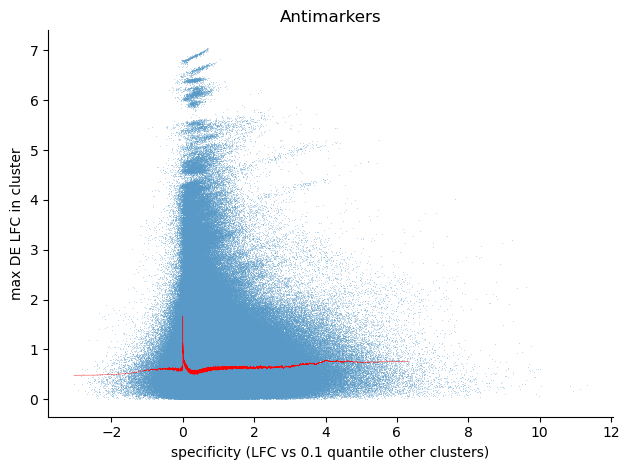

In [50]:
quantile = 0.1
coefdf = antipode.post.get_conserved_quantile_markers(discov_cluster_params,columns=adata.var.index,index=cluster_labels, q=quantile,antimarker=True)
selected_markers = antipode.post.select_marker_genes(
    coefdf, clipped_expr_df, marker=False,
    threshold=np.log(10/1e6), other_quantile=0.1)
marker_gene_order=uniqlist([selected_markers[x] for x in adata.uns['dendrogram_level_2']['categories_ordered']])

cx=coefdf.to_numpy().flatten()
cy=np.absolute(centered_discov_cluster_params).mean(0).flatten()
seaborn.scatterplot(x=cx,y=cy,s=0.2)
ma_x,ma_y=antipode.plotting.moving_average_values(cx,cy,window_size)
plt.plot(ma_x,ma_y, color='red',linewidth=0.3, label=f'Moving Average ({window_size} points)')
plt.axhline(y=ma_y.mean(),color='black',linestyle=':',linewidth=0.8)
plt.xlabel('specificity (LFC vs '+str(quantile)+' quantile other clusters)')
plt.ylabel('max DE LFC in cluster')
plt.title('Antimarkers')
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'conserved_antimarker_de_meanscatter.svg'), format='svg')
plt.show()

sc.pl.dotplot(adata,groupby=leaf_key,var_names=marker_gene_order,dendrogram='dendrogram_level_2',standard_scale='var',use_raw=False,cmap='coolwarm',save='conserved_antimarkers.svg')

# Specific

In [ ]:
quantile = 0.99
specific_coefdf = antipode.post.get_quantile_markers(clipped_expr_df, quantile)
selected_markers = antipode.post.select_marker_genes(
    specific_coefdf, clipped_expr_df, marker=True,
    threshold=np.log(10/1e6))
marker_gene_order=uniqlist([selected_markers[x] for x in adata.uns['dendrogram_level_2']['categories_ordered']])

cx=specific_coefdf.to_numpy().flatten()
cy=np.absolute(centered_discov_cluster_params).mean(0).flatten()
cy=cy[cx>0.5]
cx=cx[cx>0.5]
seaborn.scatterplot(x=cx,y=cy,s=0.2)
ma_x,ma_y=antipode.plotting.moving_average_values(cx,cy,window_size)
plt.plot(ma_x,ma_y, color='red',linewidth=0.3, label=f'Moving Average ({window_size} points)')
plt.axhline(y=ma_y.mean(),color='black',linestyle=':',linewidth=0.8)
plt.xlabel('specificity (LFC vs '+str(quantile)+' quantile other clusters)')
plt.ylabel('max DE LFC in cluster')
plt.title('Specific Markers')
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'specific_de_meanscatter.png'), format='png')
plt.show()

sc.pl.dotplot(adata,groupby=leaf_key,var_names=marker_gene_order,dendrogram='dendrogram_level_2',standard_scale='var',use_raw=False,cmap='coolwarm',)

In [52]:
coefdf.to_csv(os.path.join(model_path,'dev_level2_99quant_markers.csv'),sep='\t')

## Antimarkers

In [53]:
quantile = 0.1
coefdf = antipode.post.get_quantile_markers(clipped_expr_df, quantile)
selected_markers = antipode.post.select_marker_genes(
    coefdf, clipped_expr_df, marker=False,
    threshold=np.log(10/1e6), other_quantile=0.1)
marker_gene_order=uniqlist([selected_markers[x] for x in adata.uns['dendrogram_level_2']['categories_ordered']])

cx=coefdf.to_numpy().flatten()
cy=np.absolute(centered_discov_cluster_params).mean(0).flatten()
cy=cy[cx<-.5]
cx=cx[cx<-.5]
seaborn.scatterplot(x=cx,y=cy,s=0.2)
ma_x,ma_y=antipode.plotting.moving_average_values(cx,cy,window_size)
plt.plot(ma_x,ma_y, color='red',linewidth=0.3, label=f'Moving Average ({window_size} points)')
plt.axhline(y=ma_y.mean(),color='black',linestyle=':',linewidth=0.8)
plt.xlabel('specificity (LFC vs '+str(quantile)+' quantile other clusters)')
plt.ylabel('max DE LFC in cluster')
plt.title('Antimarkers')
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'antispecific_de_meanscatter.png'), format='png')
plt.show()

sc.pl.dotplot(adata,groupby=leaf_key,var_names=marker_gene_order,dendrogram='dendrogram_level_2',standard_scale='var',use_raw=False,cmap='coolwarm',)

100%|██████████| 380/380 [09:13<00:00,  1.46s/it]

KeyboardInterrupt



## Robust Markers

cluster - mean

In [ ]:
quantile = 0.5
coefdf = antipode.post.get_quantile_markers(clipped_expr_df, quantile)
selected_markers = antipode.post.select_marker_genes(
    coefdf, clipped_expr_df, marker=True,
    threshold=np.log(10/1e6))
marker_gene_order=uniqlist([selected_markers[x] for x in adata.uns['dendrogram_level_2']['categories_ordered']])

cx=coefdf.to_numpy().flatten()
cy=np.absolute(centered_discov_cluster_params).mean(0).flatten()
seaborn.scatterplot(x=cx,y=cy,s=0.2)
ma_x,ma_y=antipode.plotting.moving_average_values(cx,cy,window_size)
plt.plot(ma_x,ma_y, color='red',linewidth=0.3, label=f'Moving Average ({window_size} points)')
plt.axhline(y=ma_y.mean(),color='black',linestyle=':',linewidth=0.8)
plt.xlabel('specificity (LFC vs '+str(quantile)+' quantile other clusters)')
plt.ylabel('max DE LFC in cluster')
plt.title('Robust Markers')
plt.show()

sc.pl.dotplot(adata,groupby=leaf_key,var_names=marker_gene_order,dendrogram='dendrogram_level_2',standard_scale='var',use_raw=False,cmap='coolwarm',)

## Real Specific

In [ ]:
coefs=[]
real_cluster_param_df = pd.DataFrame(log_real_means.mean(0),columns=adata.var.index,index=cluster_labels)

quantile = 0.99
coefdf = antipode.post.get_quantile_markers(real_cluster_param_df, quantile)
selected_markers = select_marker_genes(
    coefdf, clipped_expr_df, marker=True,
    threshold=np.log(10/1e6))
marker_gene_order=uniqlist([selected_markers[x] for x in adata.uns['dendrogram_level_2']['categories_ordered']])

cx=coefdf.to_numpy().flatten()
cy=np.absolute(centered_discov_cluster_params).mean(0).flatten()
seaborn.scatterplot(x=cx,y=cy,s=0.2)
ma_x,ma_y=moving_average_values(cx,cy,window_size)
plt.plot(ma_x,ma_y, color='red',linewidth=0.2, label=f'Moving Average ({window_size} points)')
plt.xlabel('specificity')
plt.ylabel('max DE LFC')
plt.show()

sc.pl.dotplot(adata,groupby=leaf_key,var_names=marker_gene_order,dendrogram='dendrogram_level_2',standard_scale='var',use_raw=False,cmap='coolwarm',)
# for k,v in selected_markers.items():
#     print(v,coefdf.loc[k,v])


In [ ]:
quantile = 0.98
coefdf = antipode.post.get_conserved_quantile_markers(log_real_means,columns=adata.var.index,index=cluster_labels, q=quantile,antimarker=False)
selected_markers = antipode.post.select_marker_genes(
    coefdf, clipped_expr_df, marker=True,
    threshold=np.log(5/1e6))
marker_gene_order=uniqlist([selected_markers[x] for x in adata.uns['dendrogram_level_2']['categories_ordered']])

cx=coefdf.to_numpy().flatten()
cy=np.absolute(centered_discov_cluster_params).mean(0).flatten()
seaborn.scatterplot(x=cx,y=cy,s=0.2)
ma_x,ma_y=antipode.plotting.moving_average_values(cx,cy,window_size)
plt.plot(ma_x,ma_y, color='red',linewidth=0.3, label=f'Moving Average ({window_size} points)')
plt.axhline(y=ma_y.mean(),color='black',linestyle=':',linewidth=0.8)
plt.xlabel('specificity (LFC vs '+str(quantile)+' quantile other clusters)')
plt.ylabel('max DE LFC in cluster')
plt.title('Specific Markers')
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'conserved_specific_de_meanscatter.svg'), format='svg')
plt.show()

sc.pl.dotplot(adata,groupby=leaf_key,var_names=marker_gene_order,dendrogram='dendrogram_level_2',standard_scale='var',use_raw=False,cmap='coolwarm',save='real_conserved_specific.svg')

In [ ]:
gene_order = np.array([np.where(var_labels == x) for x in marker_gene_order]).flatten()
cat_order = list(reversed(adata.uns['dendrogram_level_2']['categories_idx_ordered']))
pie_dotplot([log_real_means[i,:,gene_order][:,cat_order].T for i in range(log_real_means.shape[0])],
            [aggr_zeros[0][i,:,gene_order][:,cat_order].T for i in range(aggr_zeros[0].shape[0])], 
            marker_gene_order, list(reversed(adata.uns['dendrogram_level_2']['categories_ordered'])),
            scale_by='column', max_radius=0.4, figsize=(28, 28))
plt.tight_layout()
plt.savefig(os.path.join(sc.settings.figdir, 'real_triple_conserved_marker_dots.svg'), format='svg')
plt.show()

## Real Antimarkers

In [ ]:
quantile = 0.1

coefdf = antipode.post.get_quantile_markers(real_cluster_param_df, quantile)
selected_markers = select_marker_genes(
    coefdf, clipped_expr_df, marker=False,
    threshold=np.log(10/1e6), other_quantile=0.1)
marker_gene_order=uniqlist([selected_markers[x] for x in adata.uns['dendrogram_level_2']['categories_ordered']])

cx=coefdf.to_numpy().flatten()
cy=np.absolute(centered_discov_cluster_params).mean(0).flatten()
seaborn.scatterplot(x=cx,y=cy,s=0.2)
ma_x,ma_y=moving_average_values(cx,cy,window_size)
plt.plot(ma_x,ma_y, color='red',linewidth=0.2, label=f'Moving Average ({window_size} points)')
plt.xlabel('specificity')
plt.ylabel('max DE LFC')
plt.show()

sc.pl.dotplot(adata,groupby=leaf_key,var_names=marker_gene_order,dendrogram='dendrogram_level_2',standard_scale='var',use_raw=False,cmap='coolwarm')
# for k,v in selected_markers.items():
#     print(v,coefdf.loc[k,v])


## Real Robust

In [ ]:
quantile = 0.5
coefdf = antipode.post.get_quantile_markers(real_cluster_param_df, quantile)
selected_markers = select_marker_genes(
    coefdf, clipped_expr_df, marker=True,
    threshold=np.log(10/1e6))
marker_gene_order=uniqlist([selected_markers[x] for x in adata.uns['dendrogram_level_2']['categories_ordered']])

cx=coefdf.to_numpy().flatten()
cy=np.absolute(centered_discov_cluster_params).mean(0).flatten()
seaborn.scatterplot(x=cx,y=cy,s=0.2)
ma_x,ma_y=moving_average_values(cx,cy,window_size)
plt.plot(ma_x,ma_y, color='red',linewidth=0.2, label=f'Moving Average ({window_size} points)')
plt.xlabel('specificity')
plt.ylabel('max DE LFC')
plt.show()

sc.pl.dotplot(adata,groupby=leaf_key,var_names=marker_gene_order,dendrogram='dendrogram_level_2',standard_scale='var',use_raw=False,cmap='coolwarm')
# for k,v in selected_markers.items():
#     print(v,coefdf.loc[k,v])


# Specificity

Follow up to above

In [54]:
log1p_means=antipode.model_functions.group_aggr_anndata(adata,[discov_key,leaf_key])[0]
log1p_means=log1p_means[:,:,((log1p_means.min(0)>0.01).sum(0)>0)]#threshold it so that we're only looking at genes that are expressed in at least 1 cell type in all 3 species
for i in range(log1p_means.shape[0]):
    log1p_means[i]=log1p_means[i]/(log1p_means[i].sum(0)+1)

100%|██████████| 1140/1140 [02:06<00:00,  9.00it/s]


In [55]:
log1p_means.shape

(3, 380, 13028)

In [56]:
randinds=np.random.choice(np.array(list(range(log1p_means[0].flatten().shape[0]))),size=10000,replace=False)

In [ ]:
xind=0
yind=1
thresh=0.05

threshold_condition = np.sqrt(log1p_means[xind].flatten()**2 + log1p_means[yind].flatten()**2) > thresh

seaborn.scatterplot(x=log1p_means[xind].flatten()[threshold_condition],y=log1p_means[yind].flatten()[threshold_condition],s=0.2)
seaborn.kdeplot(x=log1p_means[xind].flatten()[threshold_condition],y=log1p_means[yind].flatten()[threshold_condition],color='red',linestyles='--', linewidths=0.5,thresh=0.01)
plt.xlabel(adata.obs[discov_key].cat.categories[xind])
plt.ylabel(adata.obs[discov_key].cat.categories[yind])

In [ ]:
xind=0
yind=2
thresh=0.05

threshold_condition = np.sqrt(log1p_means[xind].flatten()**2 + log1p_means[yind].flatten()**2) > thresh

seaborn.scatterplot(x=log1p_means[xind].flatten()[threshold_condition],y=log1p_means[yind].flatten()[threshold_condition],s=0.2)
seaborn.kdeplot(x=log1p_means[xind].flatten()[threshold_condition],y=log1p_means[yind].flatten()[threshold_condition],color='red',linestyles='--', linewidths=0.5,thresh=0.01)
plt.xlabel(adata.obs[discov_key].cat.categories[xind])
plt.ylabel(adata.obs[discov_key].cat.categories[yind])

In [ ]:
xind=1
yind=2
thresh=0.05

threshold_condition = np.sqrt(log1p_means[xind].flatten()**2 + log1p_means[yind].flatten()**2) > thresh

seaborn.scatterplot(x=log1p_means[xind].flatten()[threshold_condition],y=log1p_means[yind].flatten()[threshold_condition],s=0.2)
seaborn.kdeplot(x=log1p_means[xind].flatten()[threshold_condition],y=log1p_means[yind].flatten()[threshold_condition],color='red',linestyles='--', linewidths=0.5,thresh=0.01)
plt.xlabel(adata.obs[discov_key].cat.categories[xind])
plt.ylabel(adata.obs[discov_key].cat.categories[yind])

In [60]:
# for k in param.keys():
#     cx=specific_coefdf.to_numpy().flatten()
#     cy=np.absolute(param[k]).mean(0).flatten()
#     seaborn.scatterplot(x=cx,y=cy,s=0.2)
#     ma_x,ma_y=antipode.plotting.moving_average_values(cx,cy,window_size)
#     plt.plot(ma_x,ma_y, color='red',linewidth=0.3, label=f'Moving Average ({window_size} points)')
#     plt.axhline(y=ma_y.mean(),color='black',linestyle=':',linewidth=0.8)
#     plt.xlabel('specificity (LFC vs '+str(quantile)+' quantile other clusters)')
#     plt.ylabel('max '+k+' LFC in cluster')
#     plt.title('Specific Markers vs '+k)
#     plt.tight_layout()
#     plt.savefig(os.path.join(sc.settings.figdir, 'specific_'+k+'_meanscatter.svg'), format='svg')
#     plt.show()


In [61]:
# import h5py
# with h5py.File('/home/matthew.schmitz/Matthew/models/1.9.1.8.5_Dev_final_noQ_IP_moredim_regionsample/analysis_inprogress.h5ad') as f:
#     var = anndata.experimental.read_elem(f['var'])
# var.to_csv('/home/matthew.schmitz/Matthew/data/taxtest/gene_lists/var.csv')

In [62]:
leaf_key='Initial_Class_markers_level_2'

In [63]:
category_ordering = pd.DataFrame({
    'Division':adata.obs.groupby(leaf_key)['Division'].value_counts().unstack().idxmax(1),
    'Initial_Class':adata.obs.groupby(leaf_key)['Initial_Class'].value_counts().unstack().idxmax(1),
    'Initial_Class_markers':adata.obs.groupby(leaf_key)['Initial_Class_markers'].value_counts().unstack().idxmax(1),
    'Neighborhood':adata.obs.groupby(leaf_key)['Neighborhood'].value_counts().unstack().idxmax(1)
})
category_ordering.index.name = None
category_ordering[leaf_key] = list(category_ordering.index)
category_ordering.astype('category')

/scratch/fast/1449202/ipykernel_2299875/1178886508.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  'Division':adata.obs.groupby(leaf_key)['Division'].value_counts().unstack().idxmax(1),
/scratch/fast/1449202/ipykernel_2299875/1178886508.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  'Initial_Class':adata.obs.groupby(leaf_key)['Initial_Class'].value_counts().unstack().idxmax(1),
/scratch/fast/1449202/ipykernel_2299875/1178886508.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or o

,Division,Initial_Class,Initial_Class_markers,Neighborhood,Initial_Class_markers_level_2
"Astro_Rx_DST,CRYAB_304",Astro,Astro_Rx,"Astro_Rx_DST,CRYAB",NN,"Astro_Rx_DST,CRYAB_304"
"Astro_Rx_DST,CRYAB_137",Astro,Astro_Rx,"Astro_Rx_DST,CRYAB",NN,"Astro_Rx_DST,CRYAB_137"
Astro_EDNRB_174,Astro,Astro,Astro_EDNRB,NN,Astro_EDNRB_174
Astro_EDNRB_83,Astro,Astro,Astro_EDNRB,NN,Astro_EDNRB_83
Astro_EDNRB_320,Astro,Astro,Astro_EDNRB,NN,Astro_EDNRB_320
...,...,...,...,...,...
MGE-Ctx_GABA_LHX6_187,TEv,MGE-Ctx_GABA,MGE-Ctx_GABA_LHX6,T,MGE-Ctx_GABA_LHX6_187
MGE-Ctx_GABA_LHX6_196,TEv,MGE-Ctx_GABA,MGE-Ctx_GABA_LHX6,T,MGE-Ctx_GABA_LHX6_196
MGE-Ctx_GABA_LHX6_501,TEv,MGE-Ctx_GABA,MGE-Ctx_GABA_LHX6,T,MGE-Ctx_GABA_LHX6_501
MGE-Ctx_GABA_LHX6_9,TEv,MGE-Ctx_GABA,MGE-Ctx_GABA_LHX6,T,MGE-Ctx_GABA_LHX6_9


In [64]:
group_Initial_Class_dict = dict(zip(category_ordering[leaf_key],category_ordering['Initial_Class_markers']))
group_class_dict = dict(zip(category_ordering[leaf_key],category_ordering['Division']))
group_neigh_dict = dict(zip(category_ordering[leaf_key],category_ordering['Neighborhood']))
Initial_Class_order = np.array([group_Initial_Class_dict[x] for x in adata.obs[leaf_key].cat.categories])
class_order = np.array([group_class_dict[x] for x in adata.obs[leaf_key].cat.categories])
neigh_order = np.array([group_neigh_dict[x] for x in adata.obs[leaf_key].cat.categories])

Neighbor


100%|██████████| 19/19 [01:11<00:00,  3.78s/it]


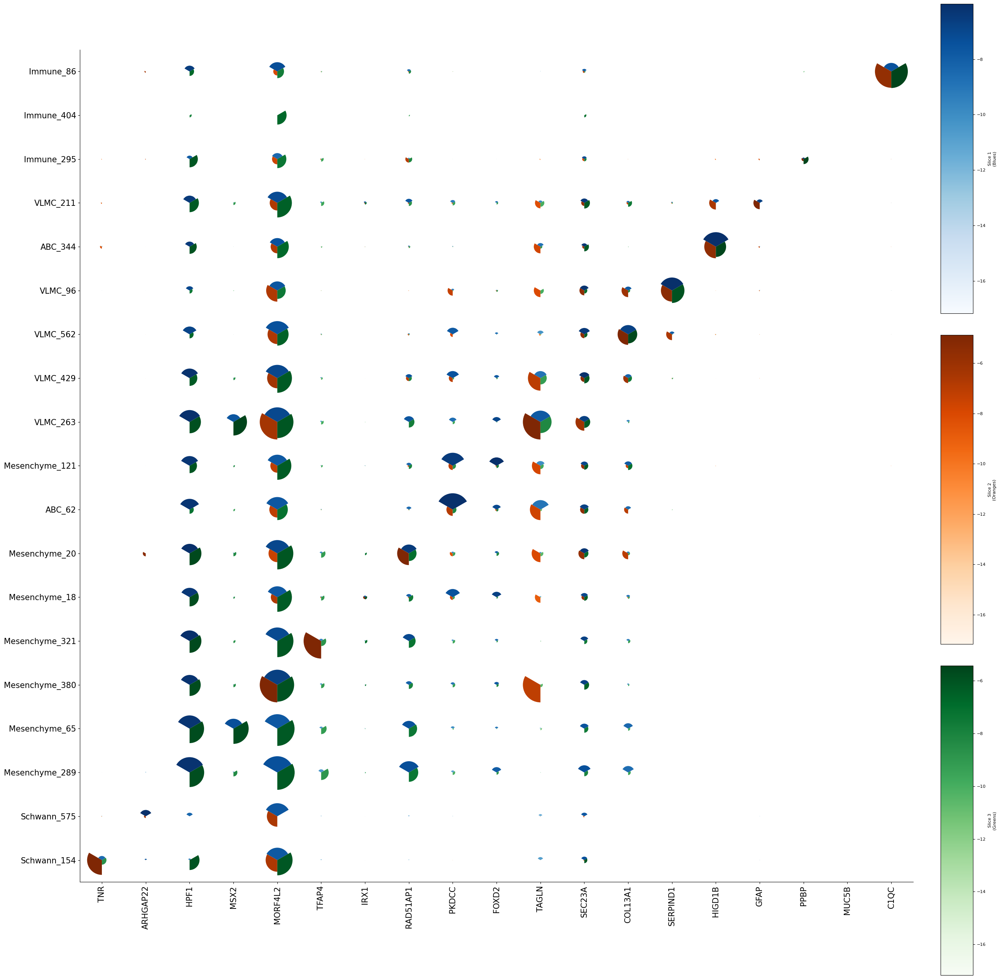

ExoNN


100%|██████████| 15/15 [00:57<00:00,  3.82s/it]


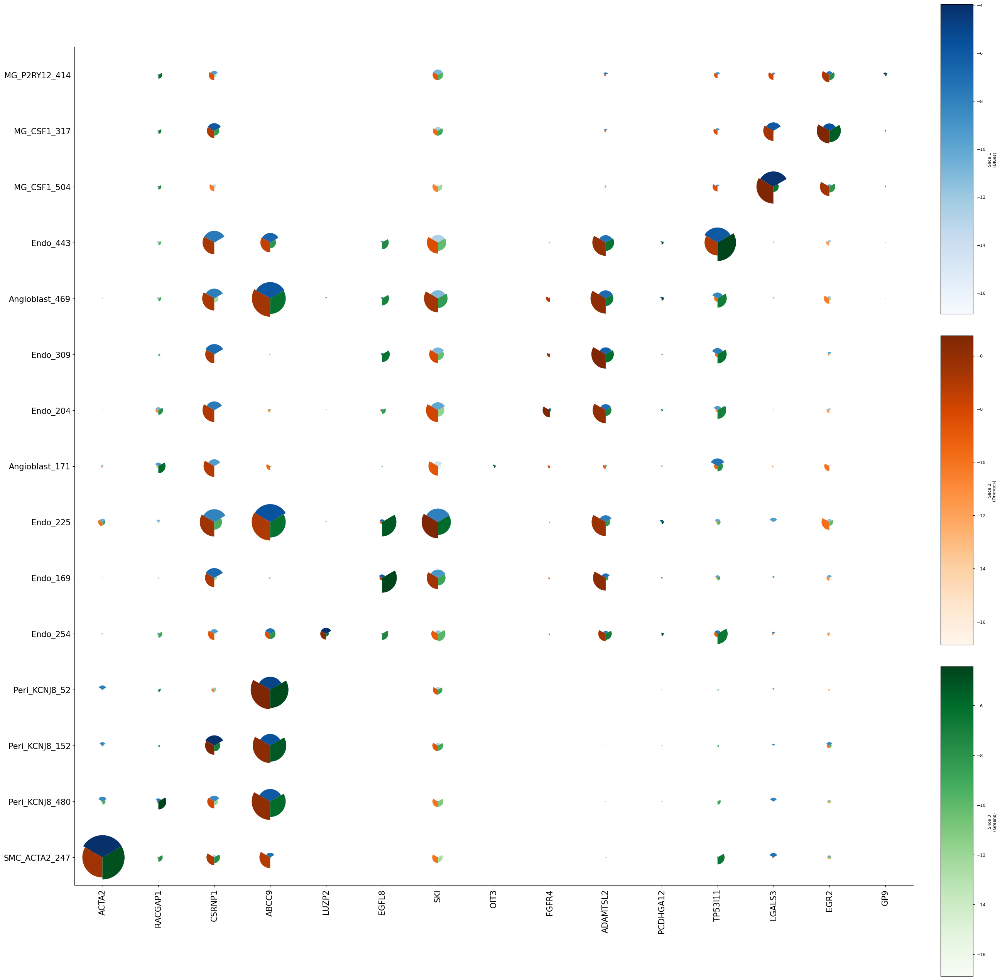

DMR


100%|██████████| 73/73 [04:37<00:00,  3.81s/it]


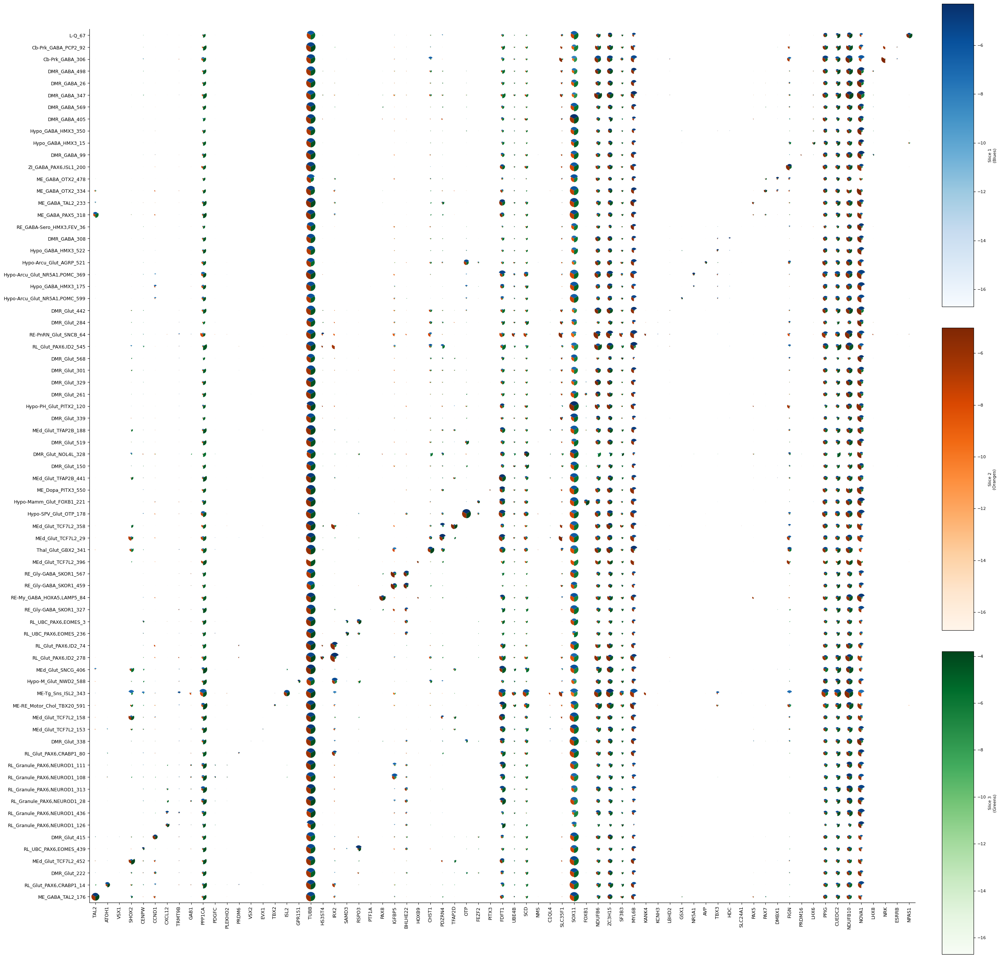

NN


100%|██████████| 89/89 [05:28<00:00,  3.70s/it]


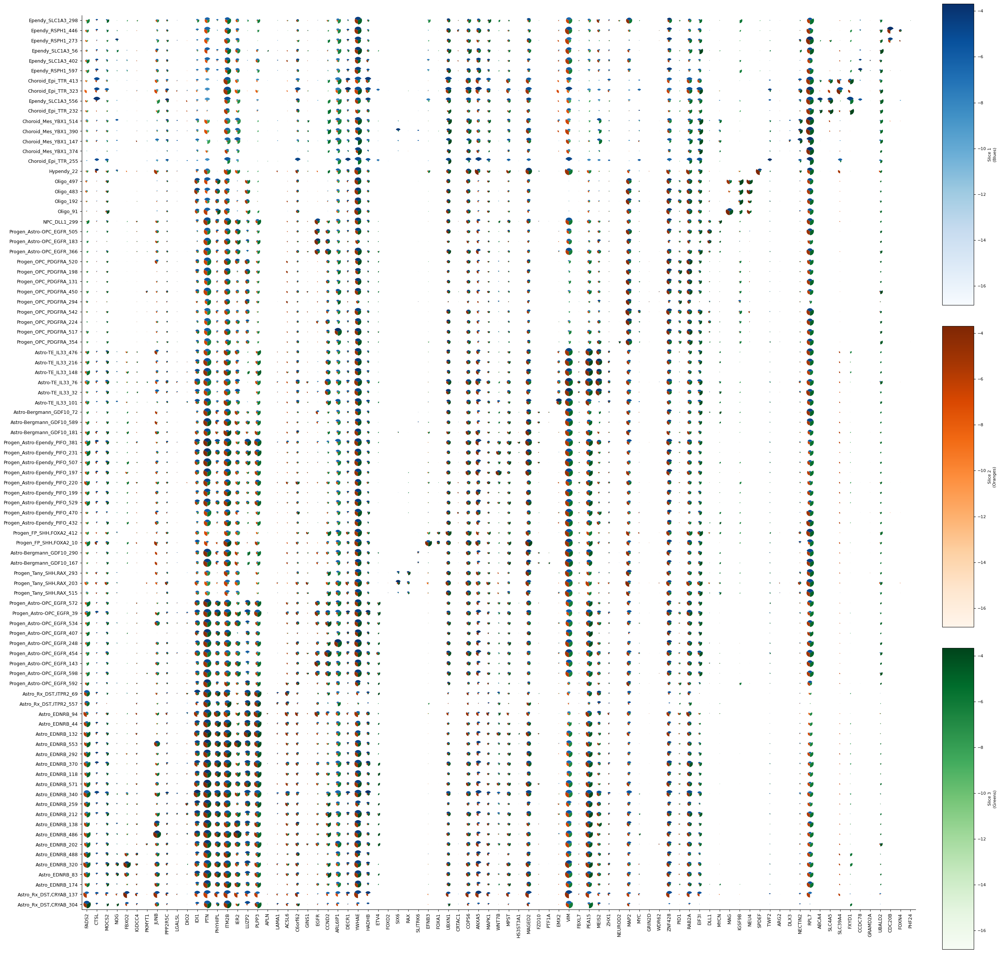

P


100%|██████████| 95/95 [05:48<00:00,  3.66s/it]


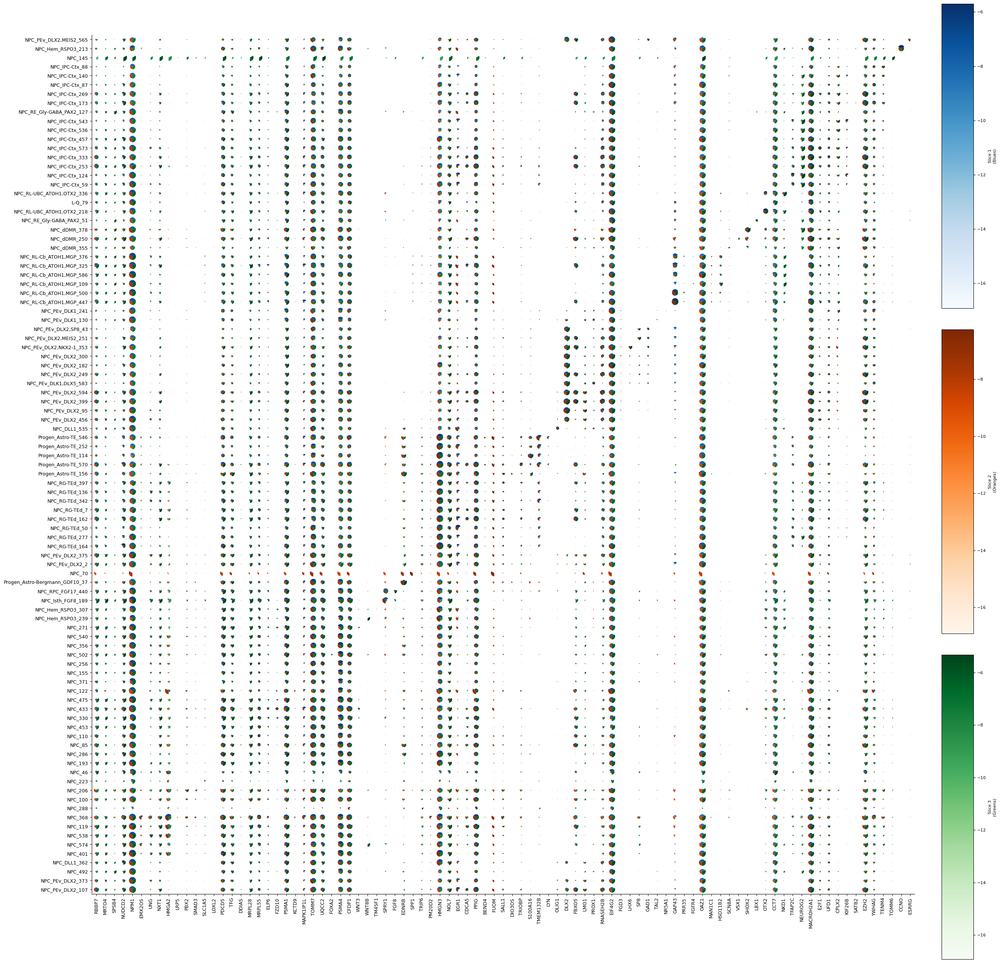

T


100%|██████████| 89/89 [05:57<00:00,  4.01s/it]


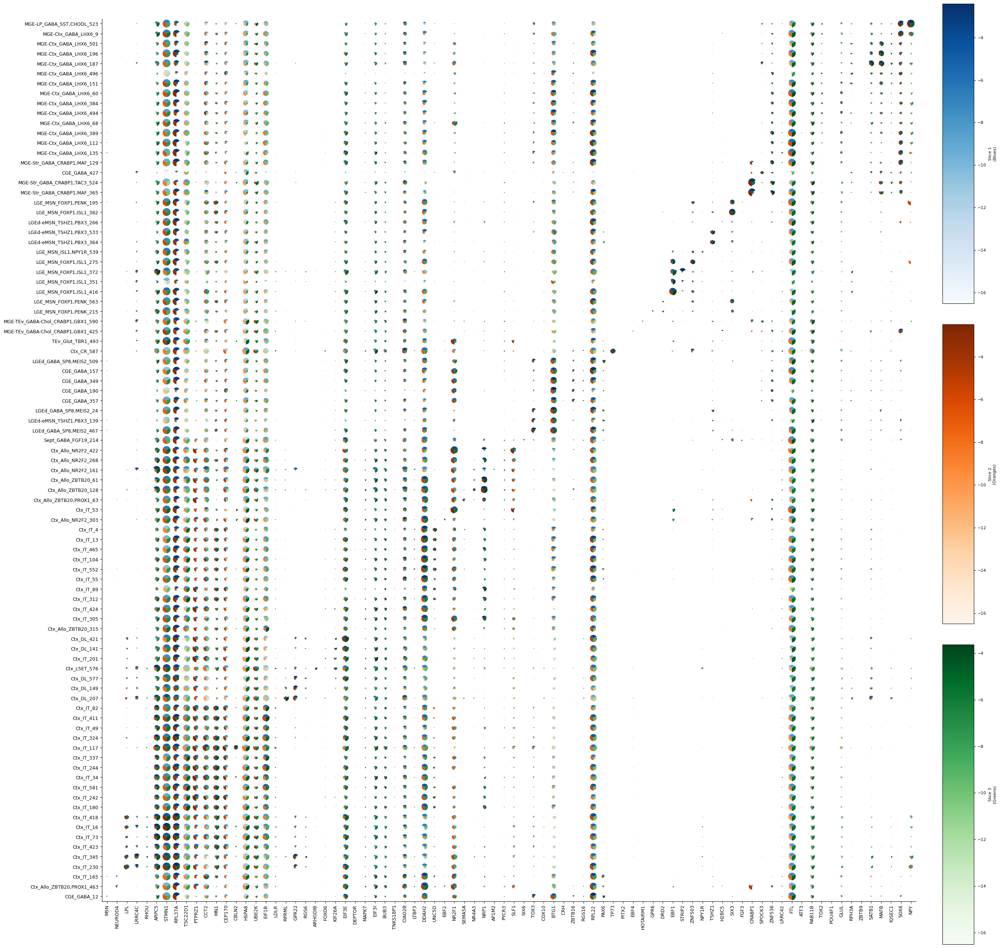

In [65]:
for c in set(neigh_order):
    print(c)
    cur_log_real_means = log_real_means[:,neigh_order==c,:]
    categories = adata.obs[leaf_key].cat.categories[neigh_order==c]
    cur_aggr_zeros = aggr_zeros[0][:,neigh_order==c,:]
    clipped_expr_df = pd.DataFrame(cur_log_real_means.mean(0),columns=adata.var.index,index=categories)
    coefdf = antipode.post.get_conserved_quantile_markers(cur_log_real_means,columns=adata.var.index,index=categories, q=0.99,antimarker=False)
    selected_markers = antipode.post.select_marker_genes(
        coefdf, clipped_expr_df, marker=True,
        threshold=np.log(5/1e6))
    marker_gene_order=antipode.post.uniqlist([selected_markers.get(x,'AQP4') for x in categories])
    gene_order = np.array([np.where(adata.var.index == x) for x in marker_gene_order]).flatten()
    pie_dotplot([cur_log_real_means[i,:,gene_order].T for i in range(cur_log_real_means.shape[0])],
                [cur_aggr_zeros[i,:,gene_order].T for i in range(cur_aggr_zeros.shape[0])], 
                marker_gene_order, categories,
                scale_by='column', max_radius=0.4, figsize=(28, 28),fontsize_mul=1.5)
    plt.savefig(os.path.join(sc.settings.figdir, c+'_triple_conserved_marker_dots.svg'), format='svg')
    plt.show()

In [66]:
log_real_sc_means,real_mean_sc_levels=antipode.model_functions.get_real_leaf_means(adata,discov_key,'Initial_Class_markers',layer=layer_key)
real_sc_means=pd.DataFrame(log_real_sc_means.mean(0),columns=adata.var.index,index=real_mean_sc_levels['Initial_Class_markers'])
real_sc_means=real_sc_means.loc[real_mean_sc_levels['Initial_Class_markers'],:]

100%|██████████| 98/98 [02:21<00:00,  1.44s/it]


In [67]:
def prop_zeros(x,axis=-1):
    return(np.mean(x>0.,axis=axis))
aggr_sc_zeros=antipode.model_functions.group_aggr_anndata(adata,[discov_key,'Initial_Class_markers'],layer=layer_key,agg_func=prop_zeros,normalize=True)

100%|██████████| 294/294 [03:44<00:00,  1.31it/s]


In [68]:
group_class_dict = dict(zip(category_ordering['Initial_Class_markers'],category_ordering['Division']))
group_neigh_dict = dict(zip(category_ordering['Initial_Class_markers'],category_ordering['Neighborhood']))
class_order = np.array([group_class_dict[x] for x in adata.obs['Initial_Class_markers'].cat.categories])
neigh_order = np.array([group_neigh_dict[x] for x in adata.obs['Initial_Class_markers'].cat.categories])

DMR_Glut


100%|██████████| 3/3 [00:10<00:00,  3.65s/it]


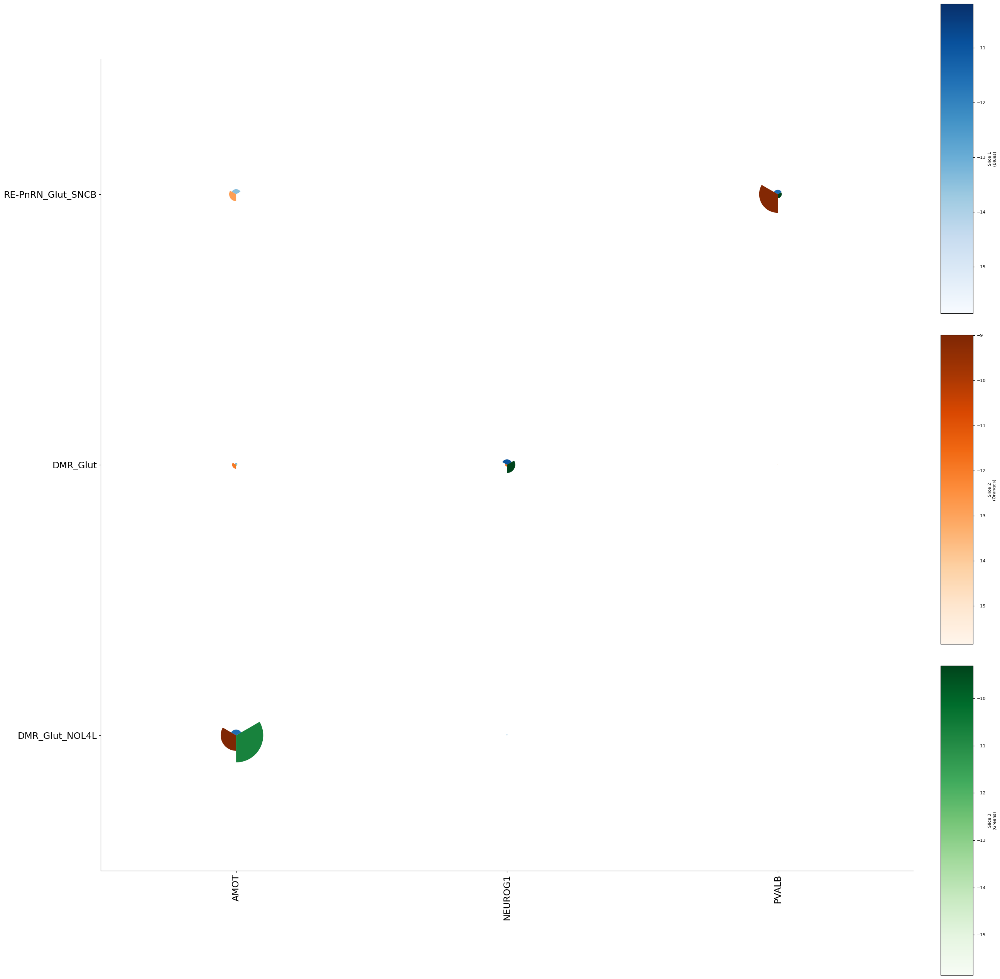

RL_Glut


100%|██████████| 4/4 [00:14<00:00,  3.59s/it]


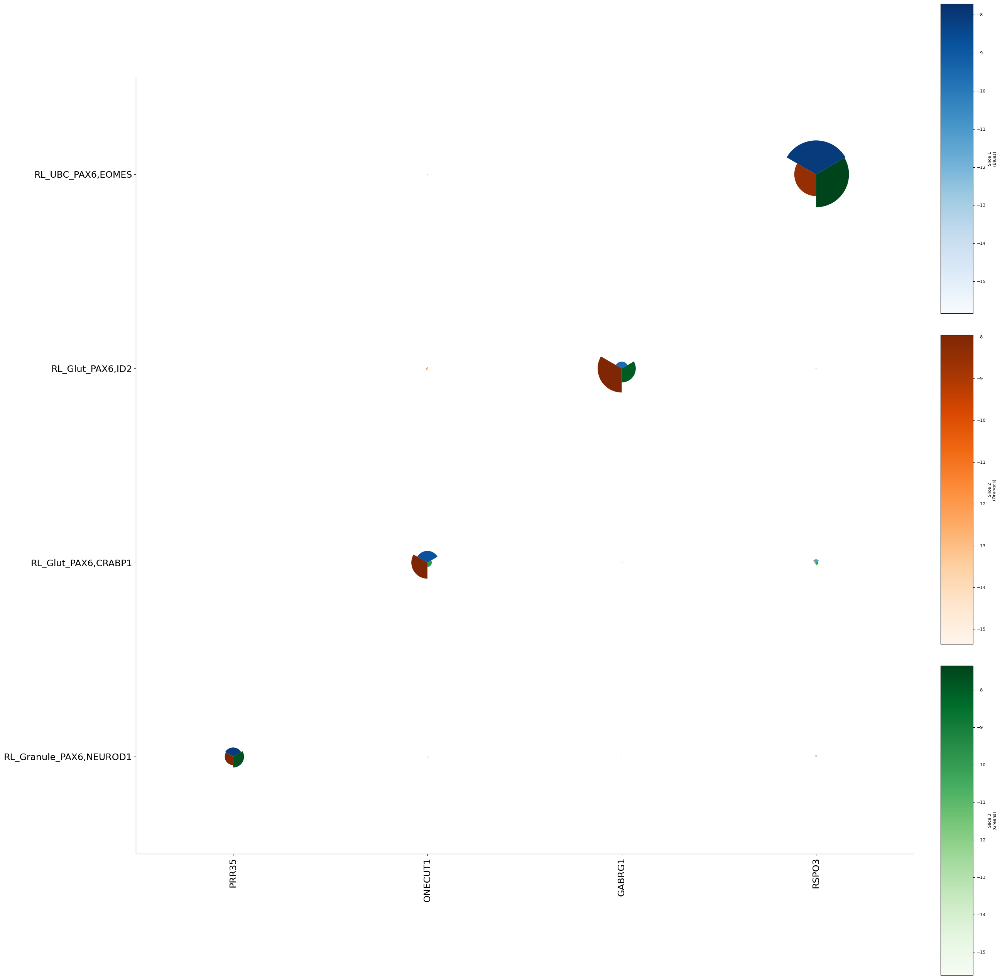

Choroid


100%|██████████| 2/2 [00:07<00:00,  3.92s/it]


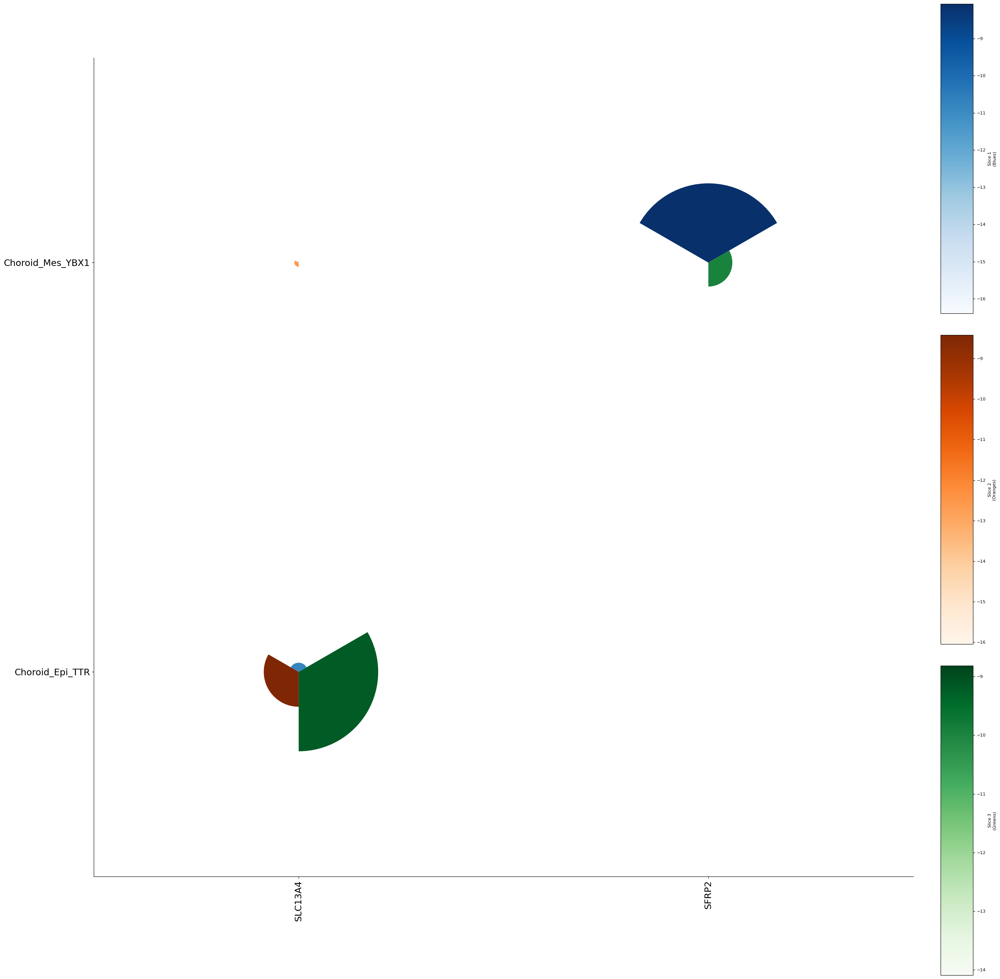

Ependy


100%|██████████| 3/3 [00:10<00:00,  3.54s/it]


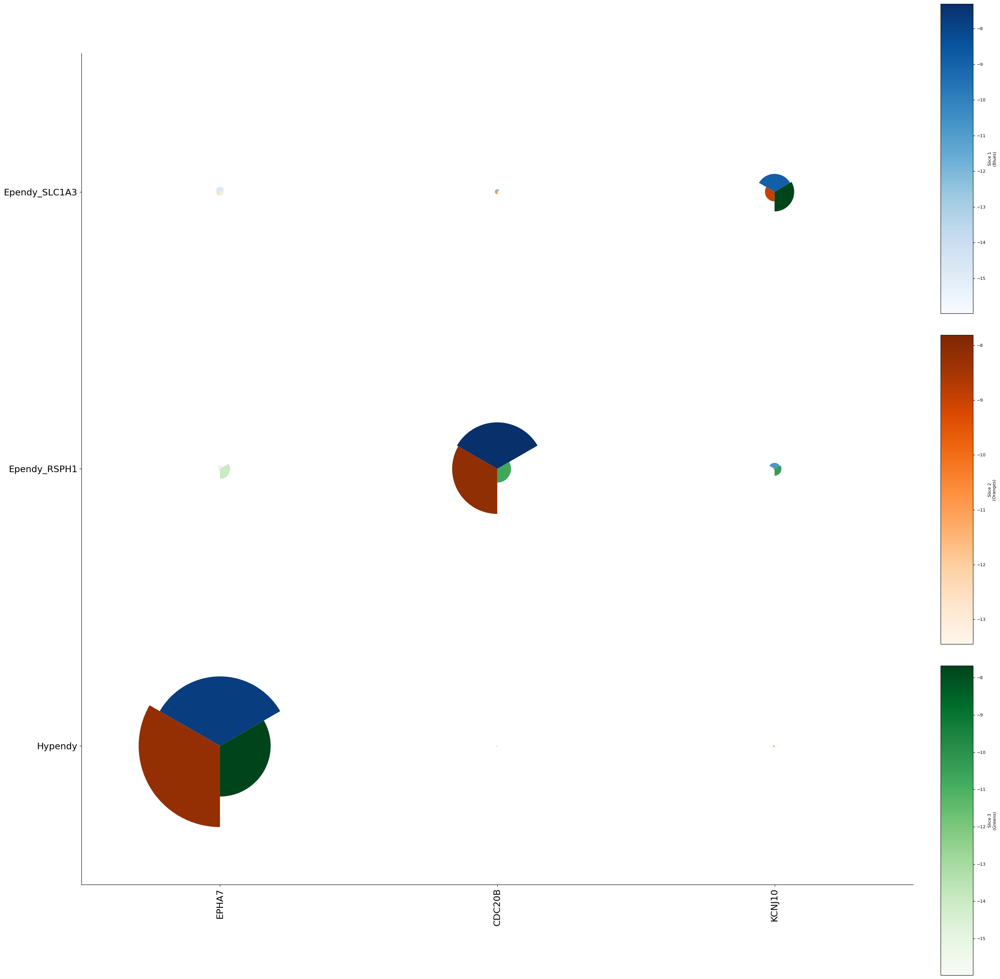

MEd


100%|██████████| 3/3 [00:10<00:00,  3.62s/it]


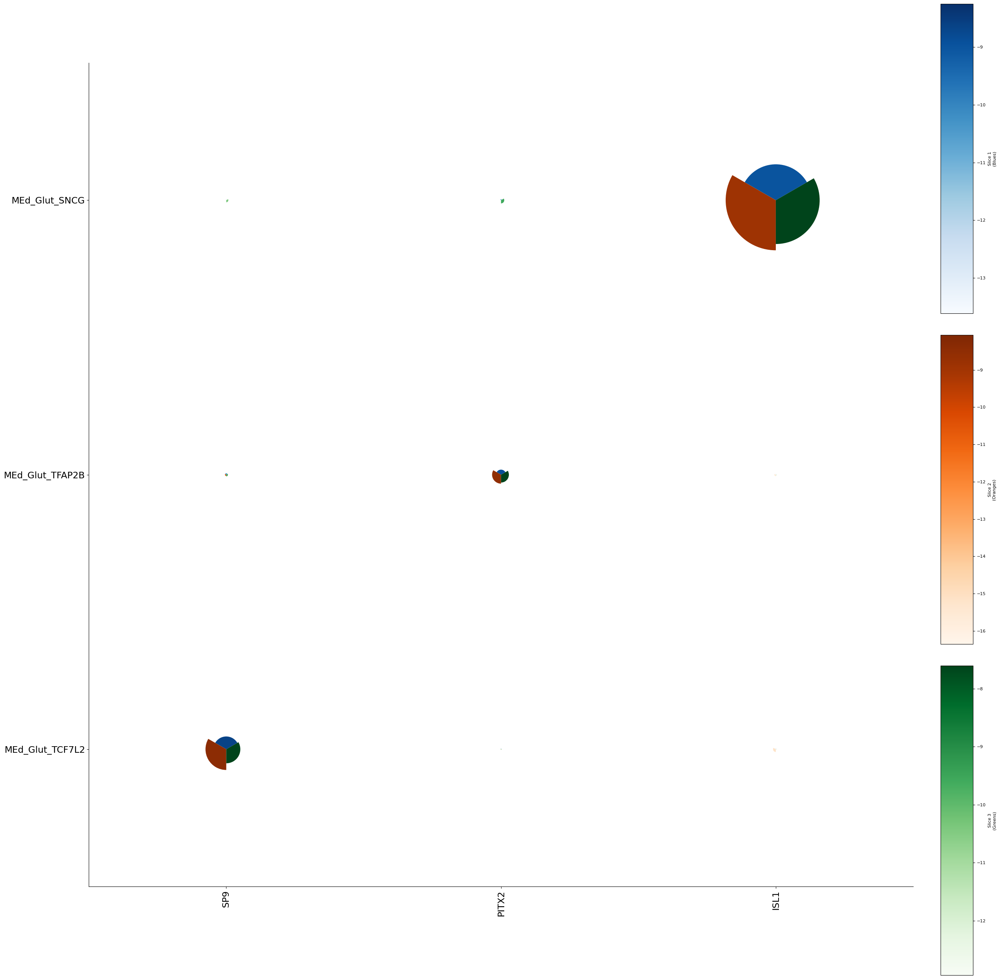

DE-ME_GABA


100%|██████████| 5/5 [00:19<00:00,  3.93s/it]


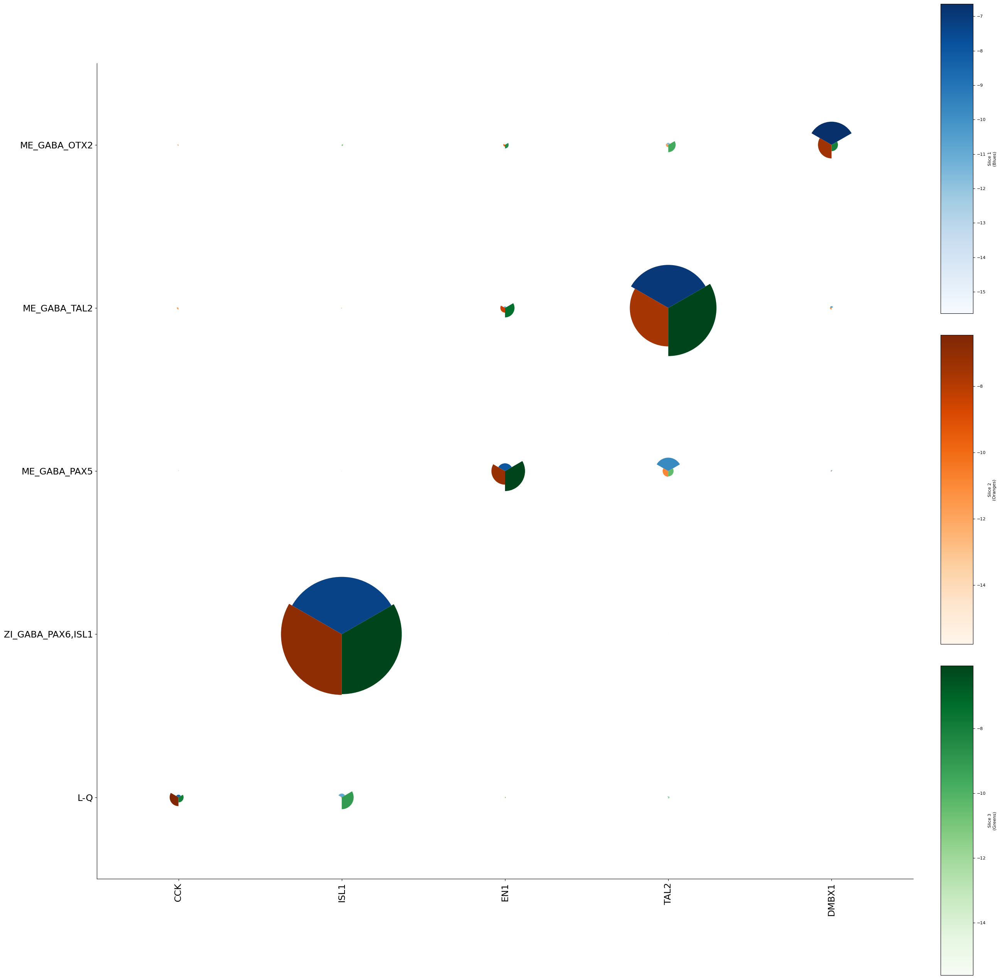

Mesenchyme


100%|██████████| 3/3 [00:11<00:00,  3.70s/it]


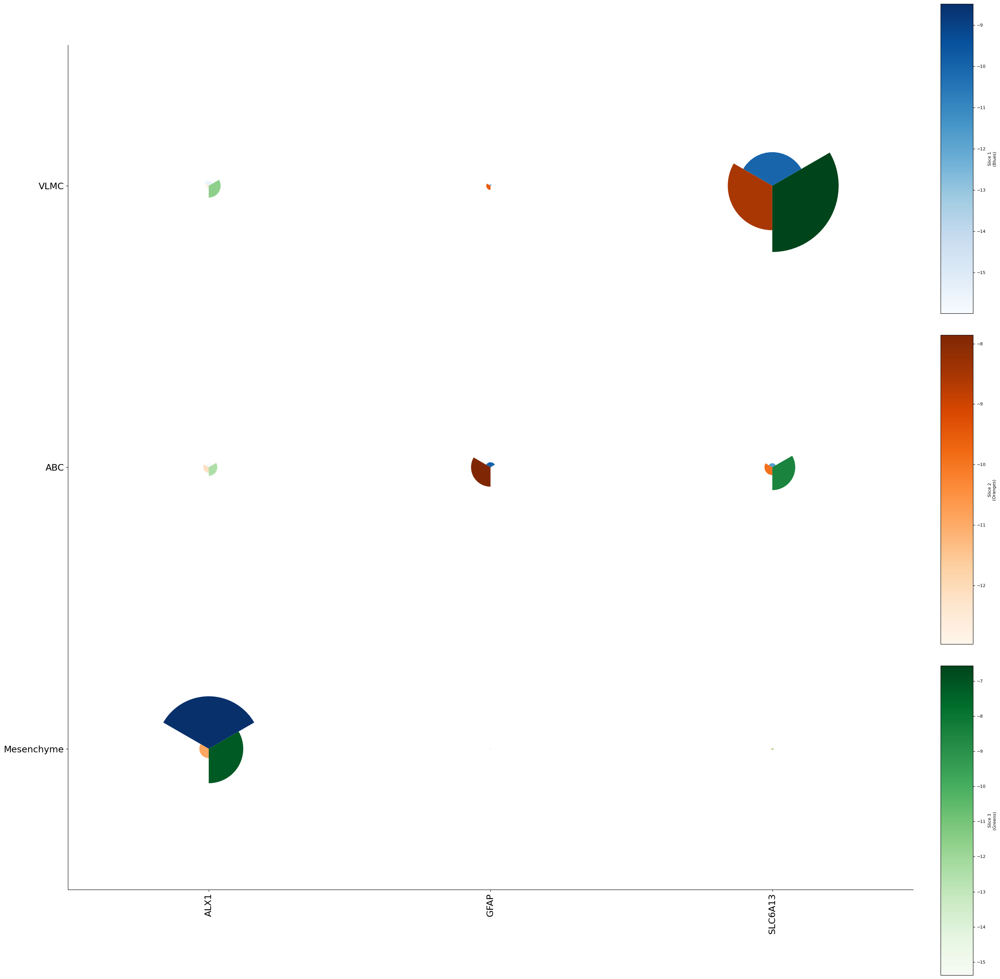

Hypo_Glut


100%|██████████| 4/4 [00:14<00:00,  3.54s/it]


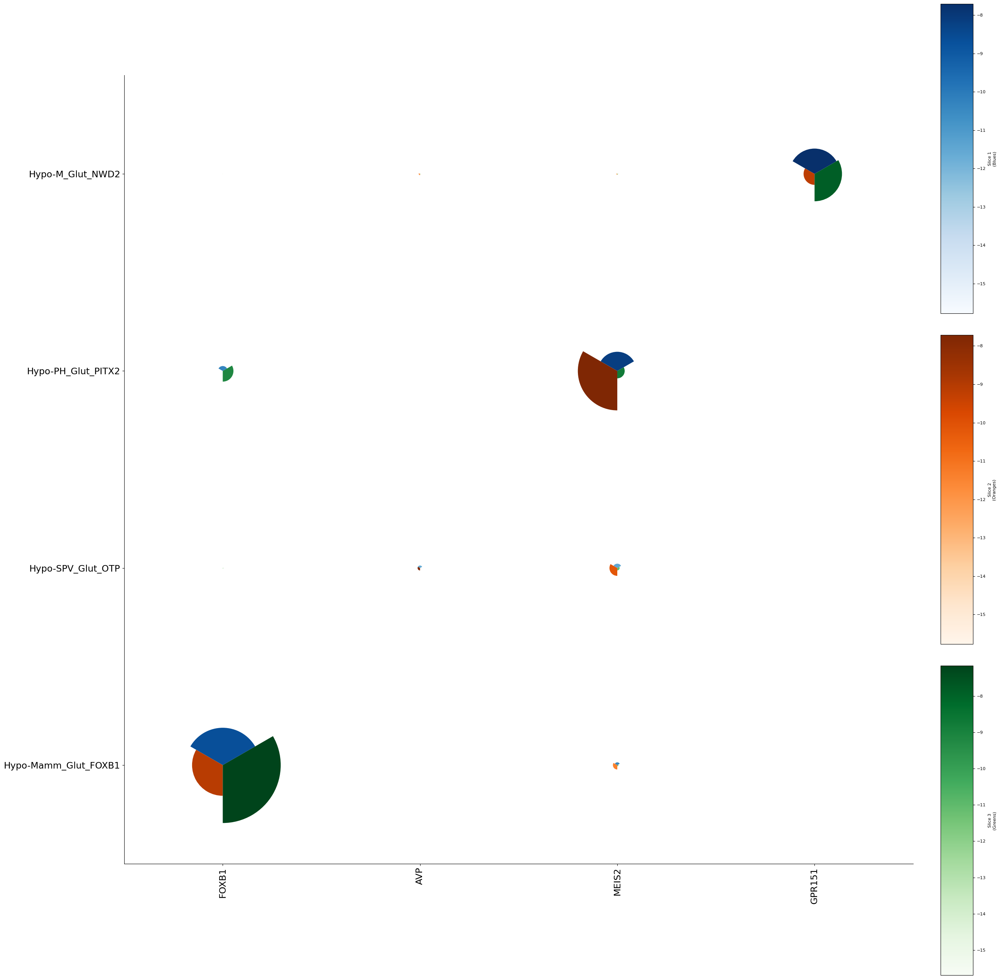

Oligo


100%|██████████| 2/2 [00:07<00:00,  3.77s/it]


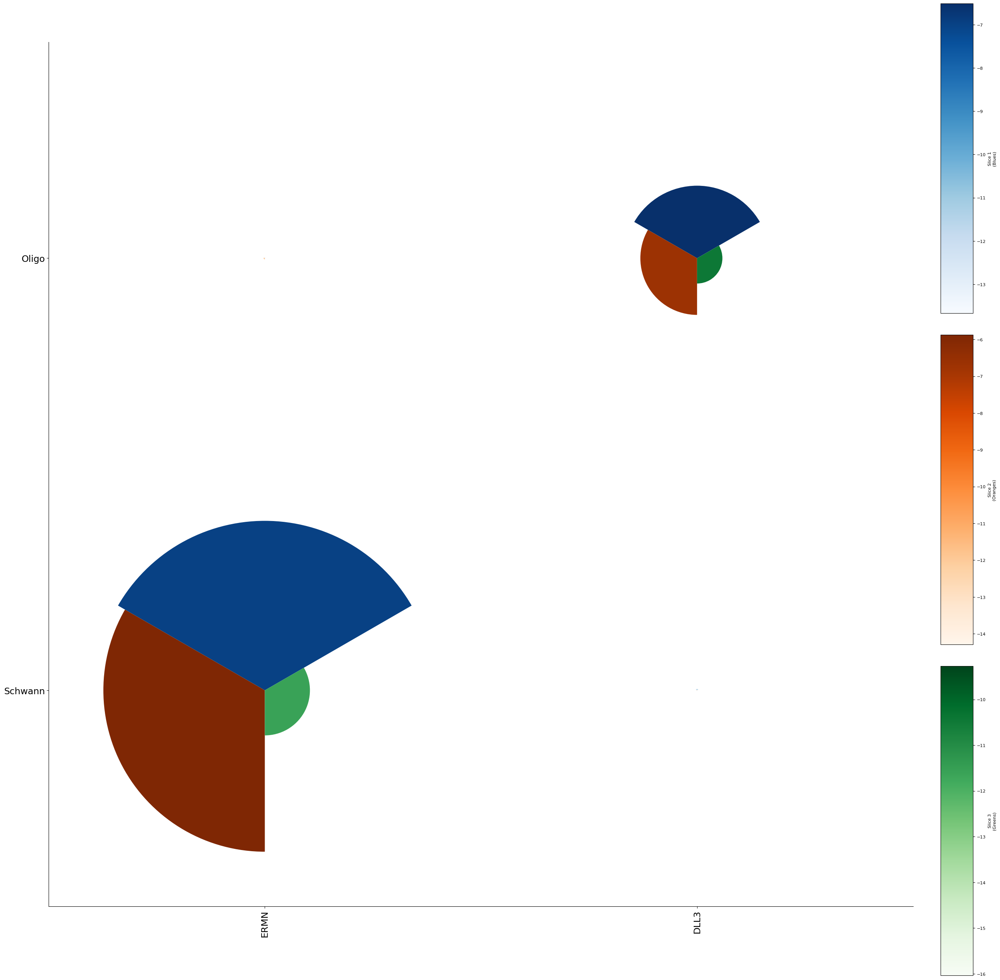

Sensory


  0%|          | 0/1 [00:00<?, ?it/s]/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/numpy/lib/_nanfunctions_impl.py:1633: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
100%|██████████| 1/1 [00:00<00:00, 29.85it/s]


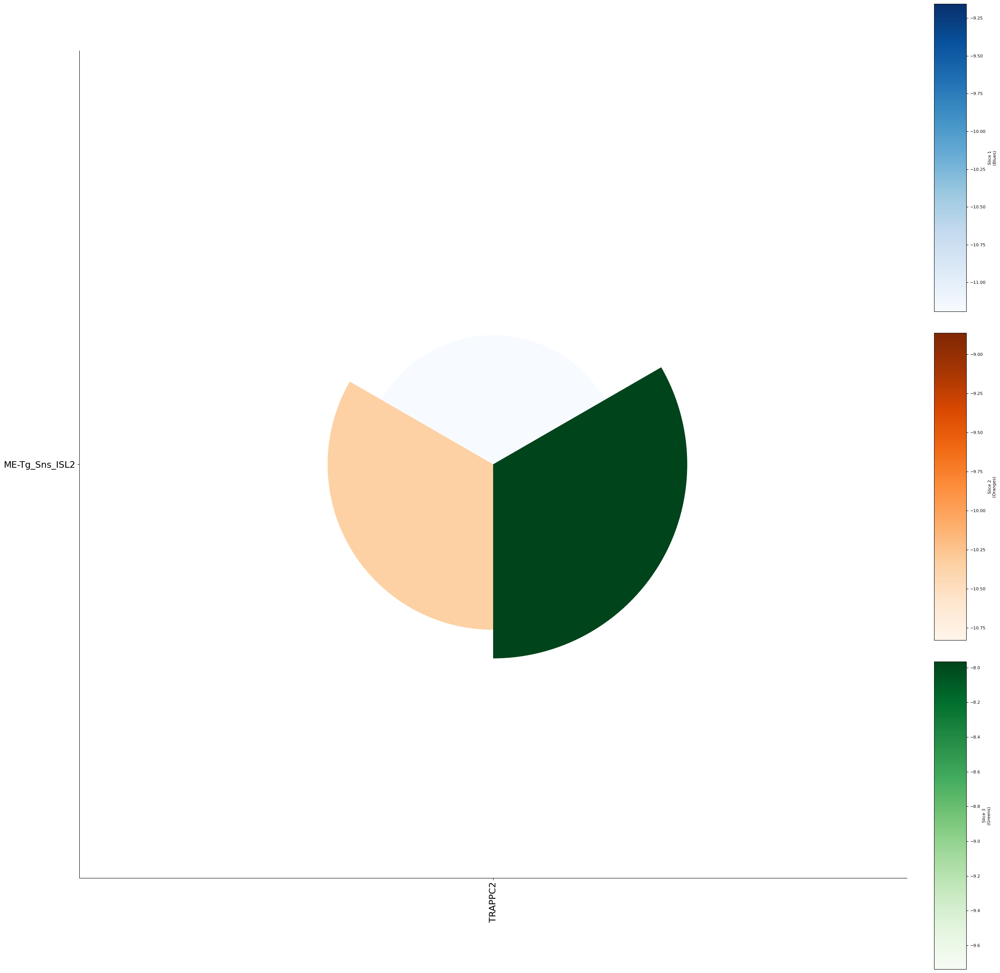

MG


100%|██████████| 2/2 [00:07<00:00,  3.84s/it]


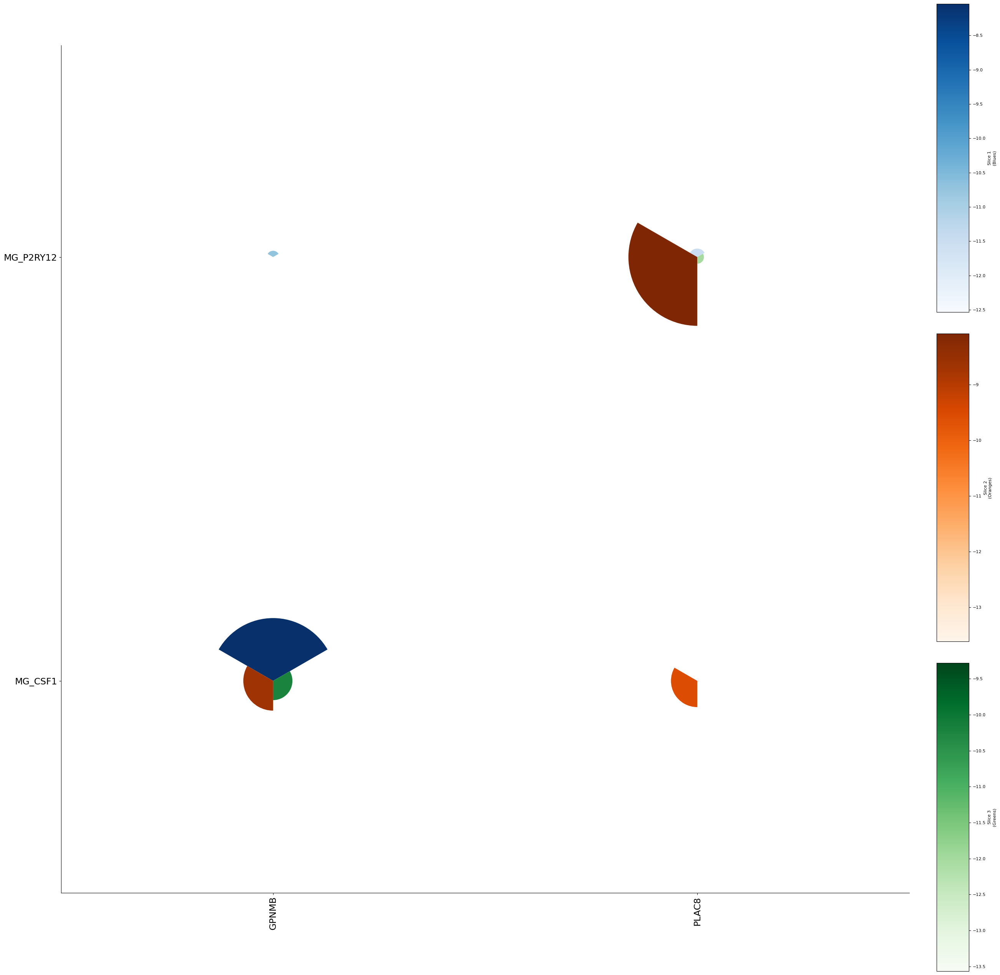

Motor


  0%|          | 0/1 [00:00<?, ?it/s]/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/numpy/lib/_nanfunctions_impl.py:1633: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
100%|██████████| 1/1 [00:00<00:00, 888.06it/s]


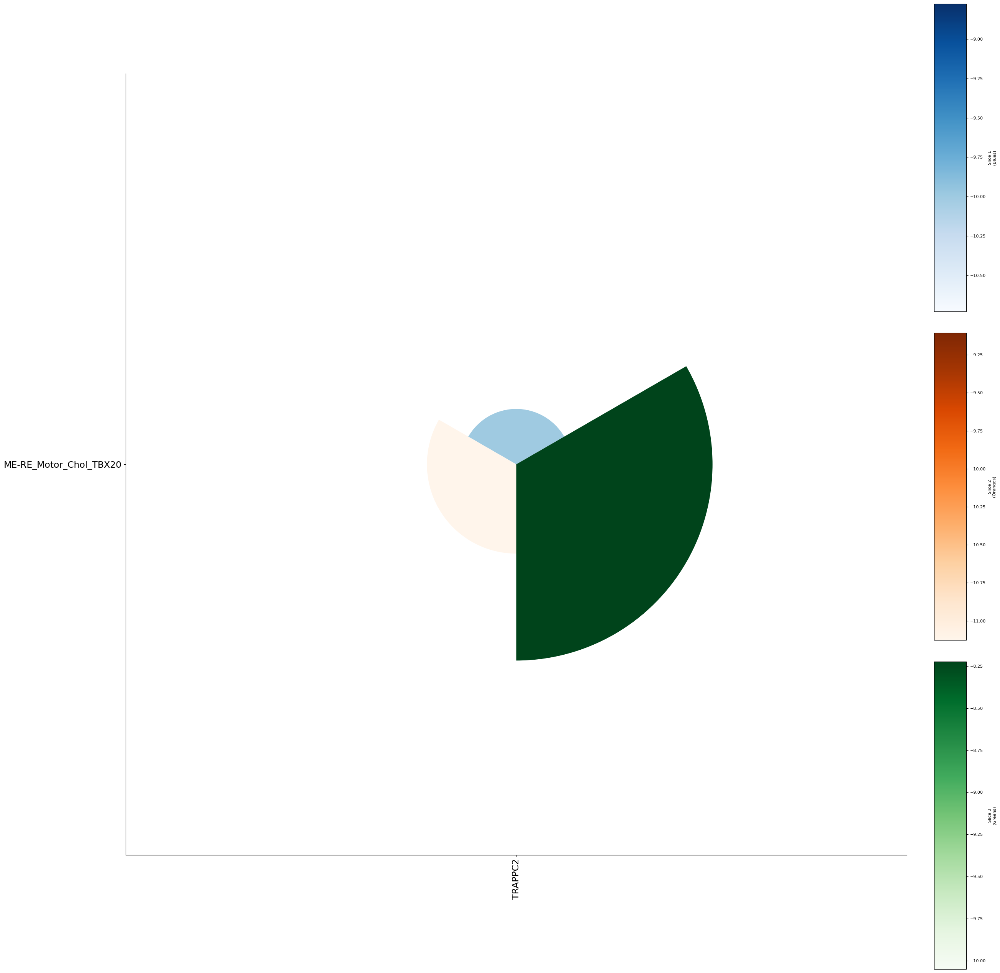

GPC


100%|██████████| 7/7 [00:25<00:00,  3.60s/it]


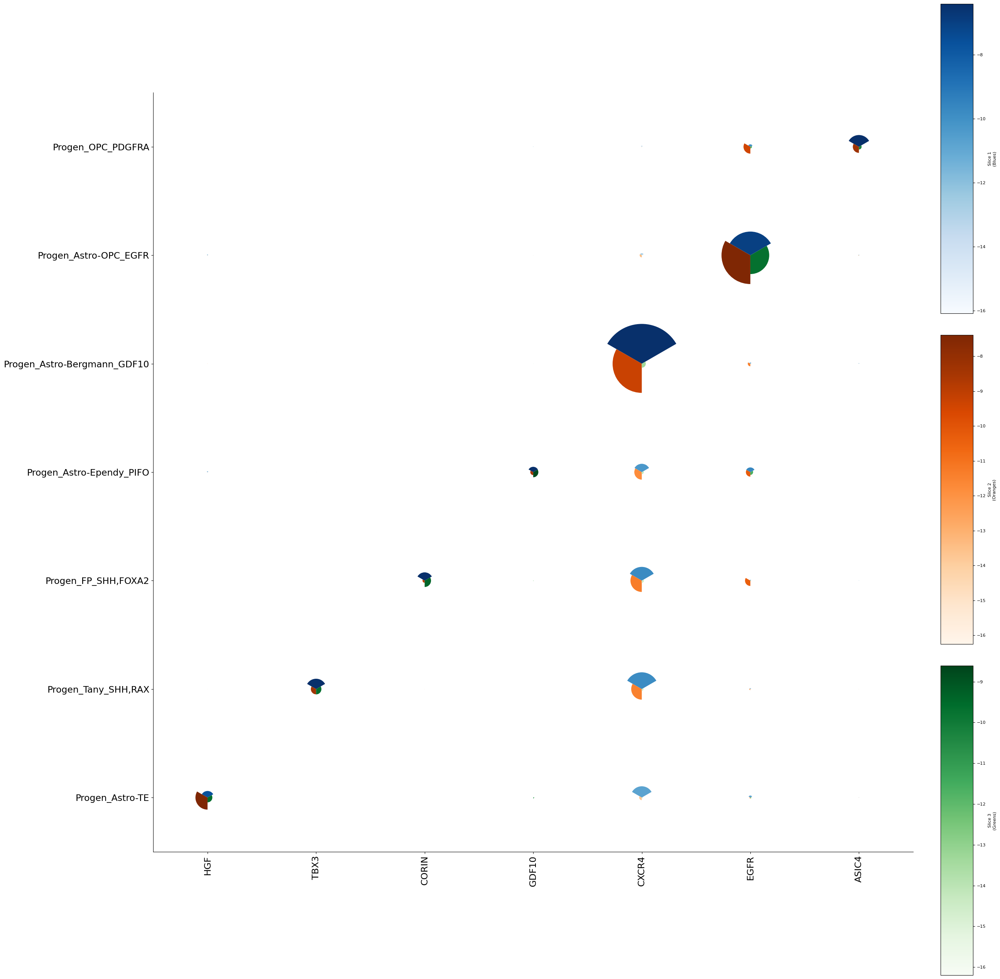

TEd


100%|██████████| 7/7 [00:24<00:00,  3.56s/it]


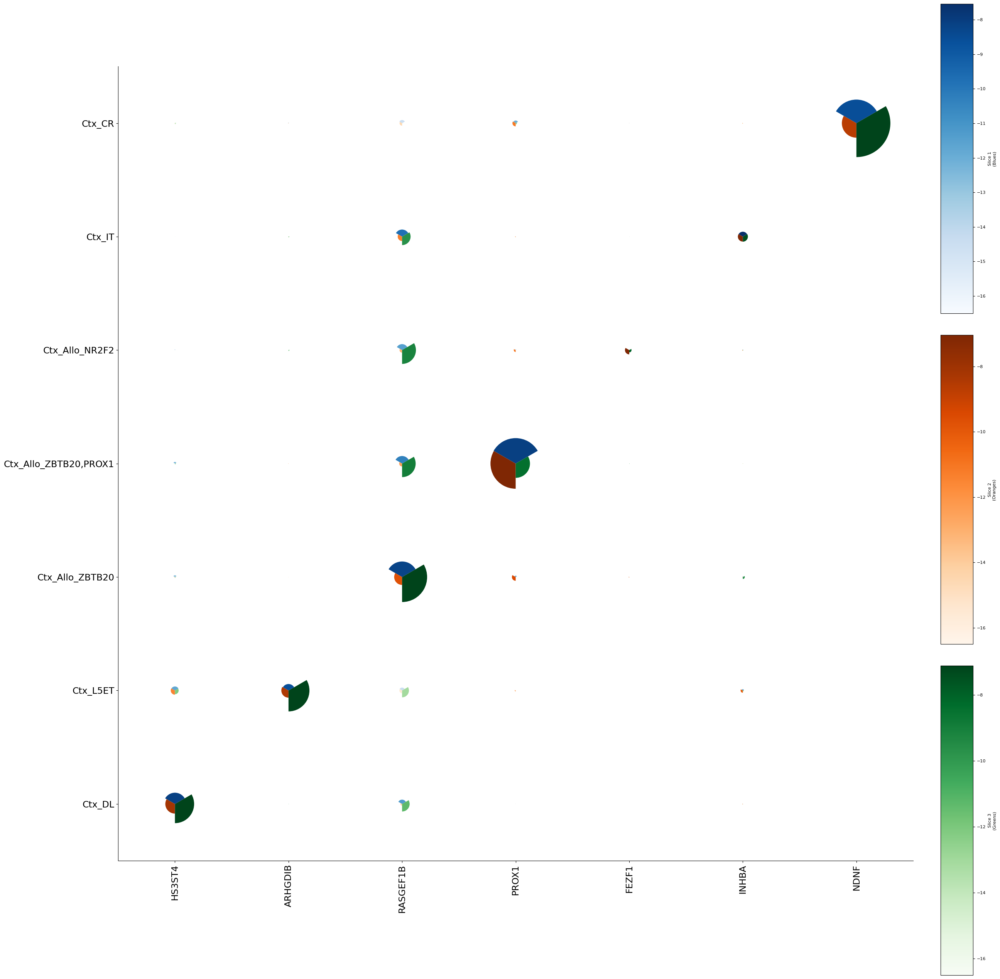

Astro


100%|██████████| 5/5 [00:19<00:00,  3.95s/it]


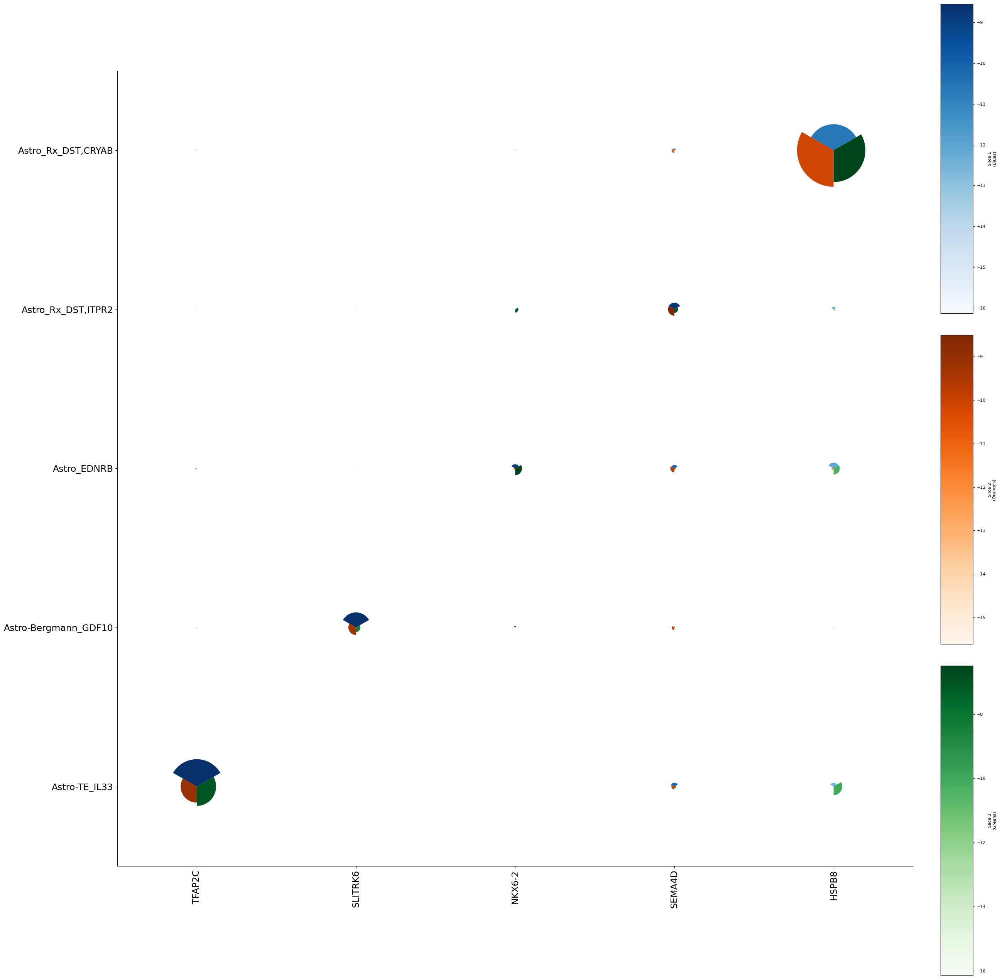

DEd


  0%|          | 0/1 [00:00<?, ?it/s]/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/numpy/lib/_nanfunctions_impl.py:1633: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
100%|██████████| 1/1 [00:00<00:00, 869.29it/s]


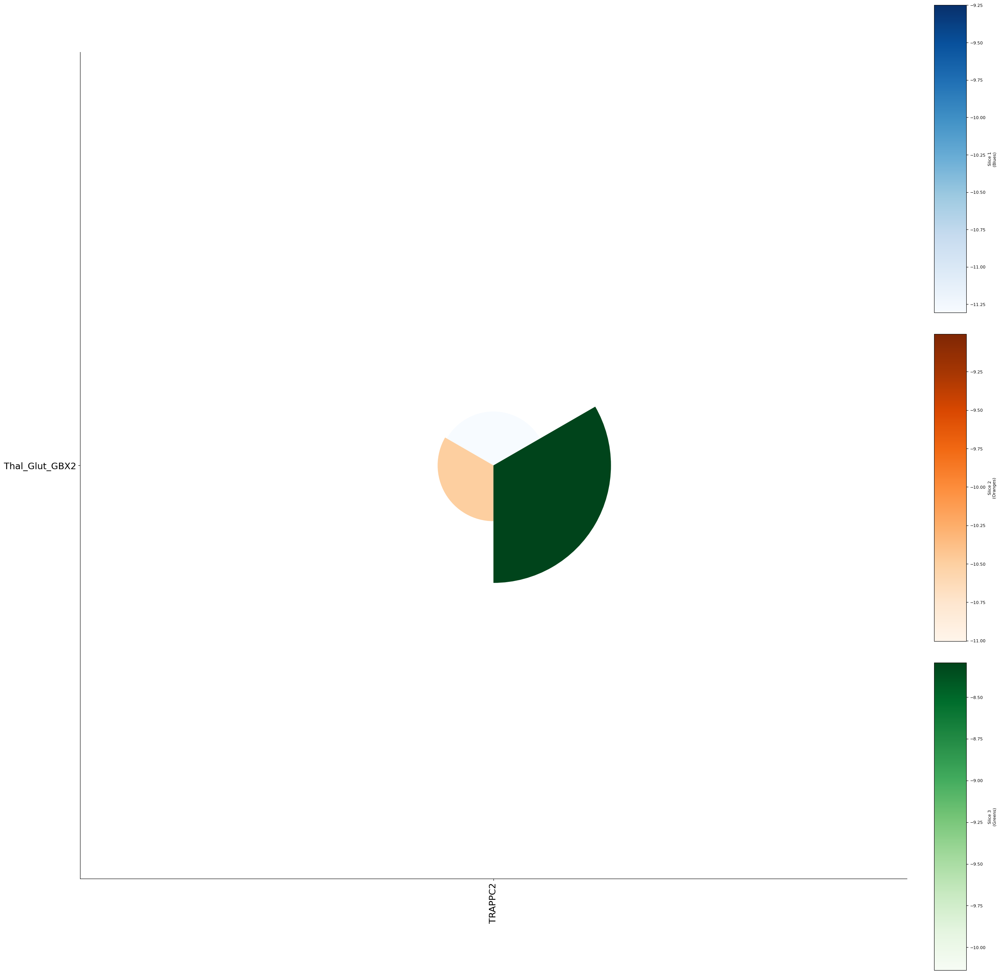

DMR_GABA


100%|██████████| 3/3 [00:10<00:00,  3.64s/it]


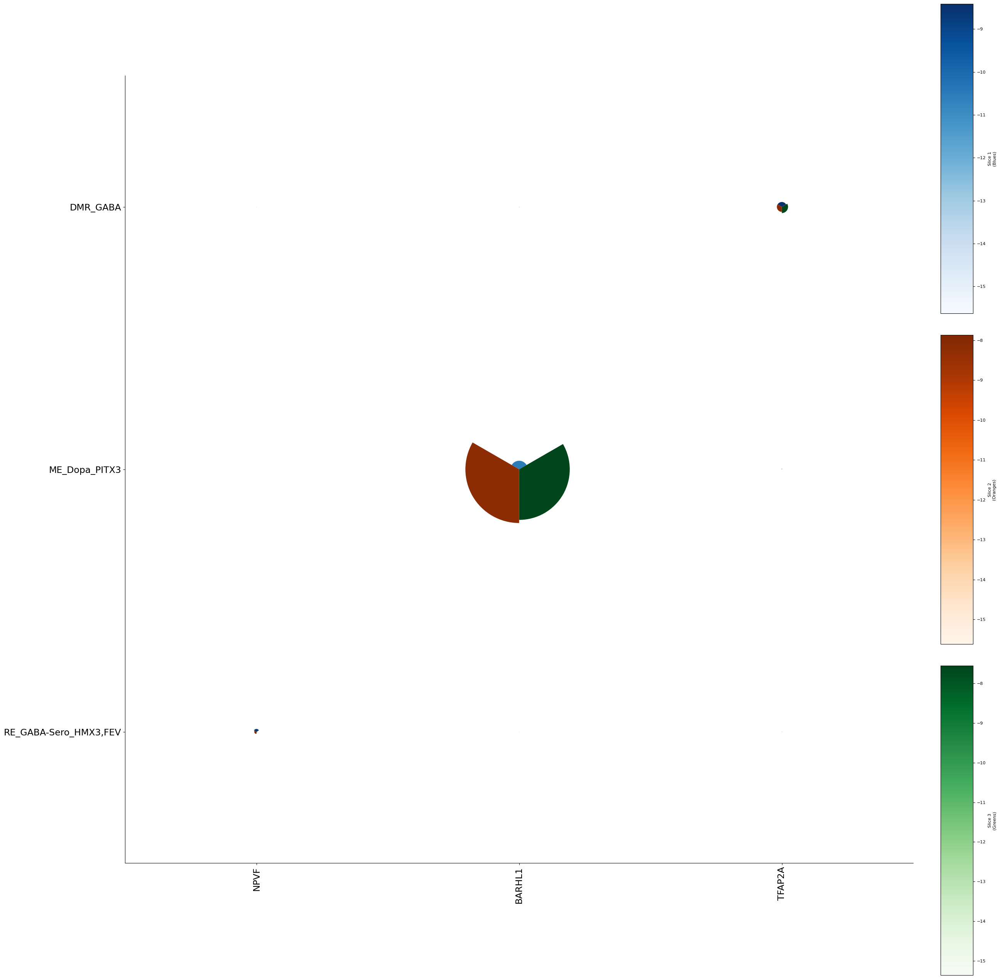

TEv


100%|██████████| 13/13 [00:47<00:00,  3.62s/it]


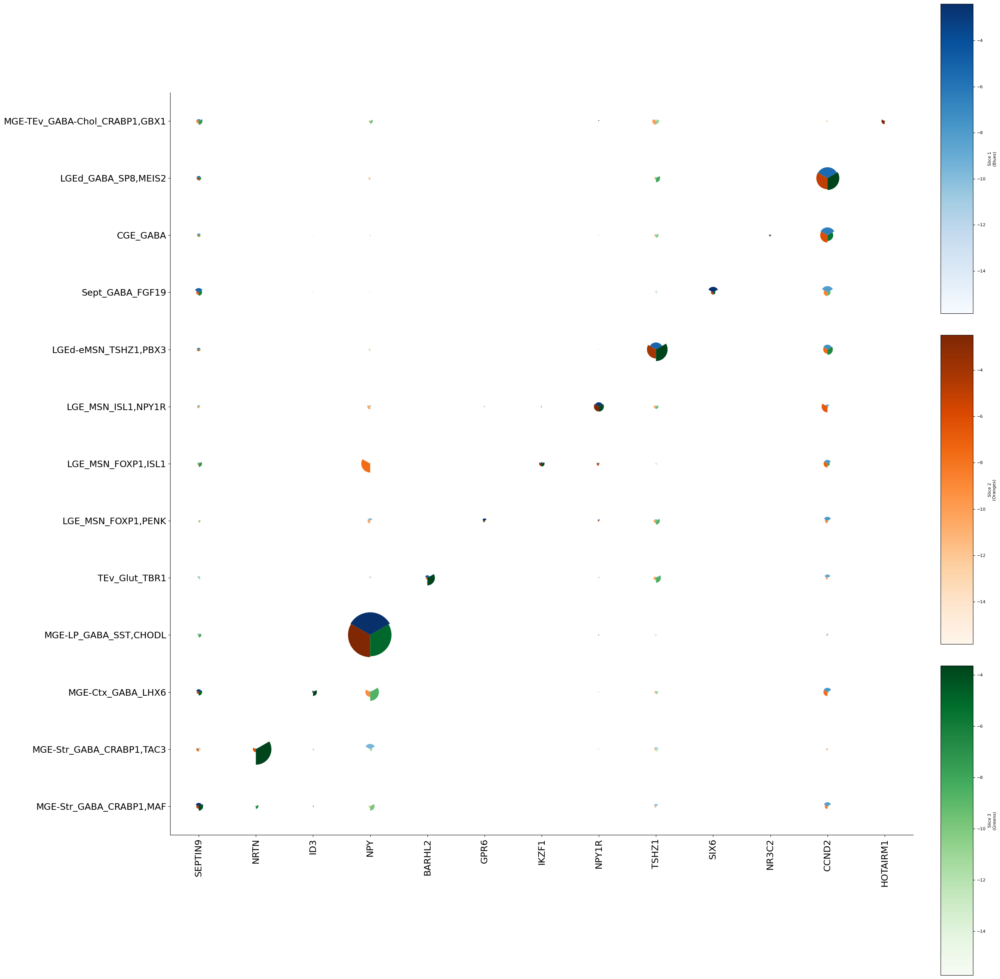

NPC


100%|██████████| 17/17 [01:02<00:00,  3.68s/it]


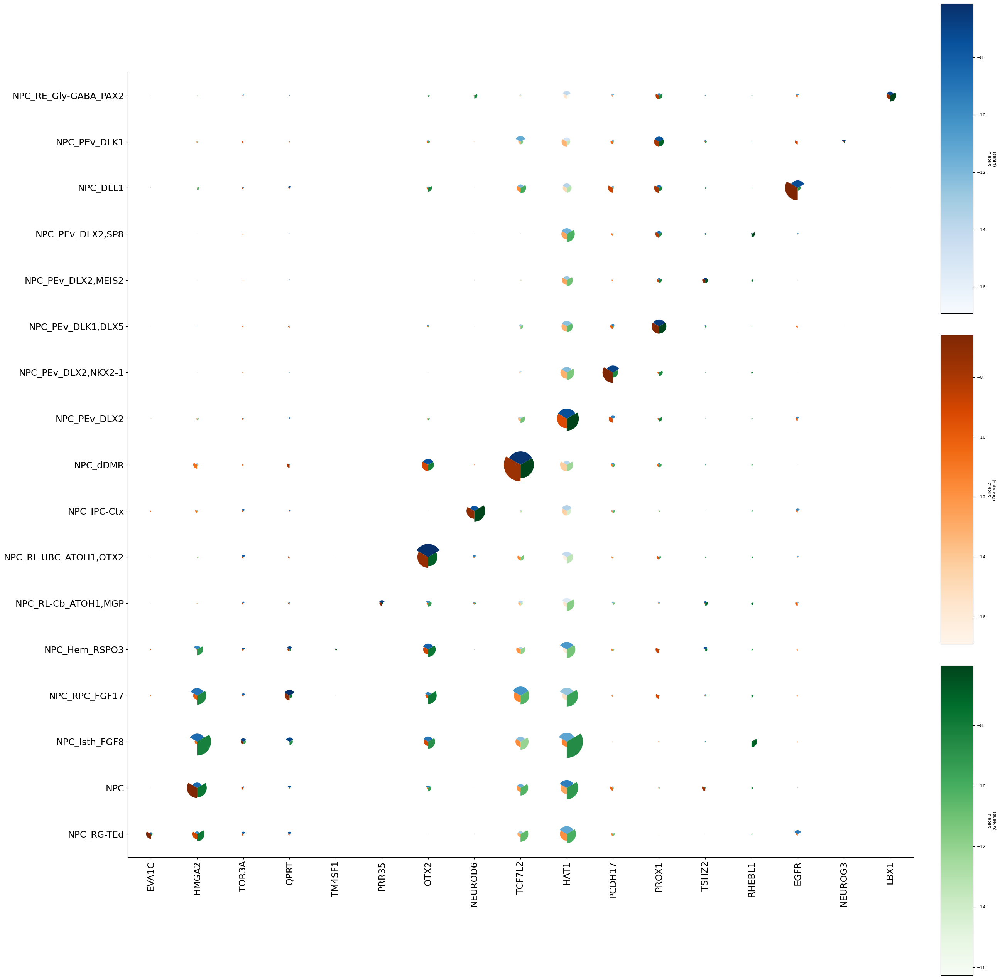

RE_GABA


100%|██████████| 4/4 [00:14<00:00,  3.62s/it]


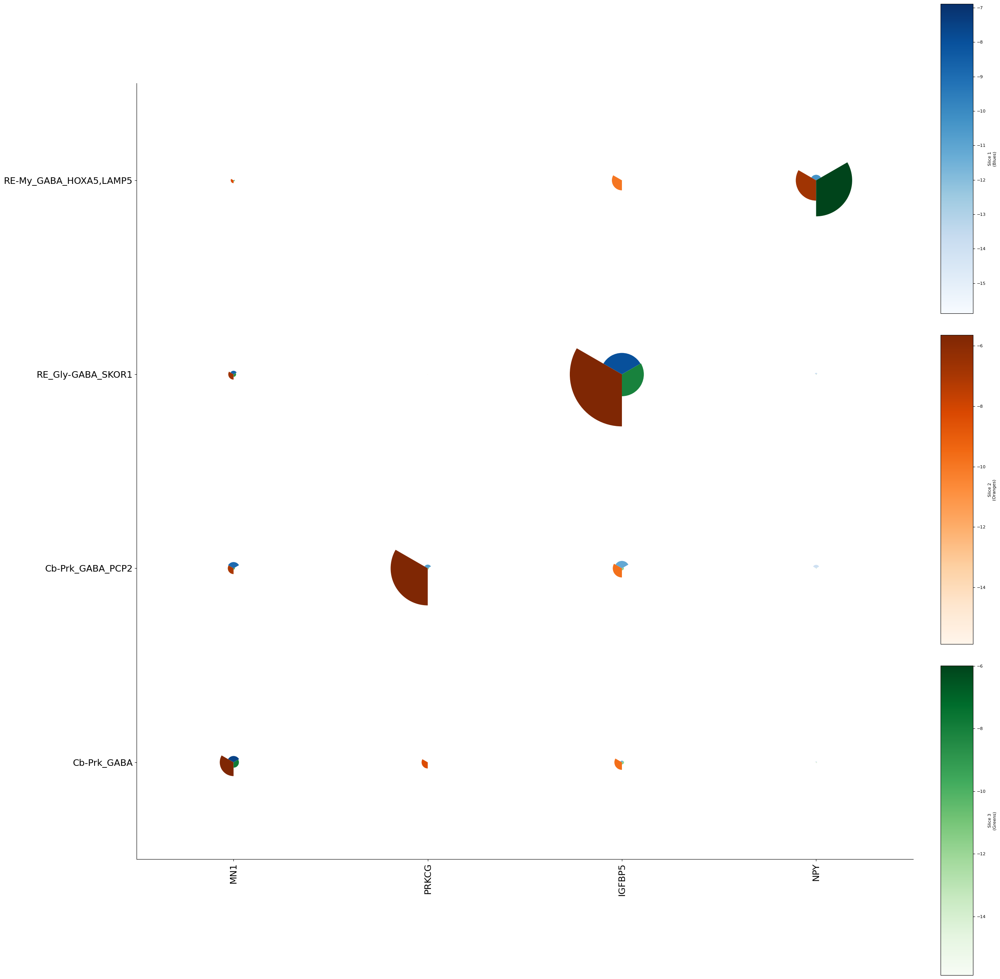

Vascular


100%|██████████| 4/4 [00:14<00:00,  3.62s/it]


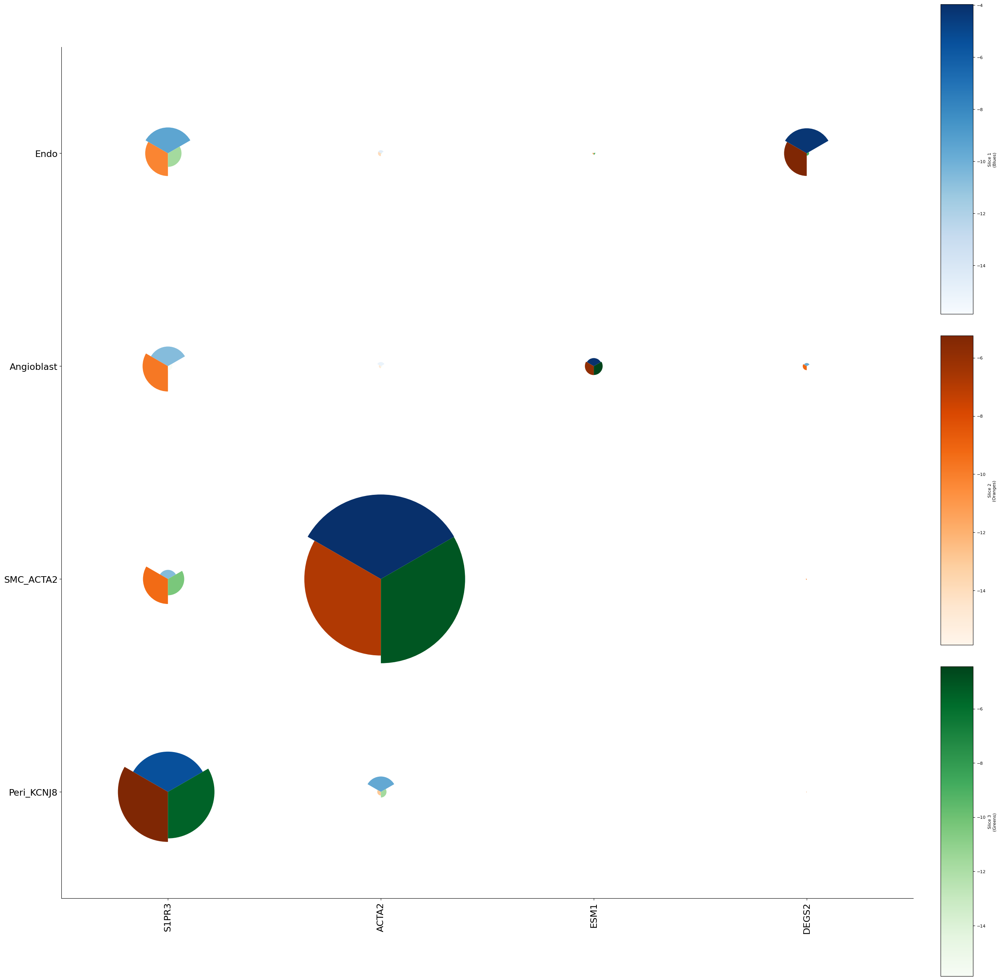

PEv


100%|██████████| 3/3 [00:11<00:00,  3.70s/it]


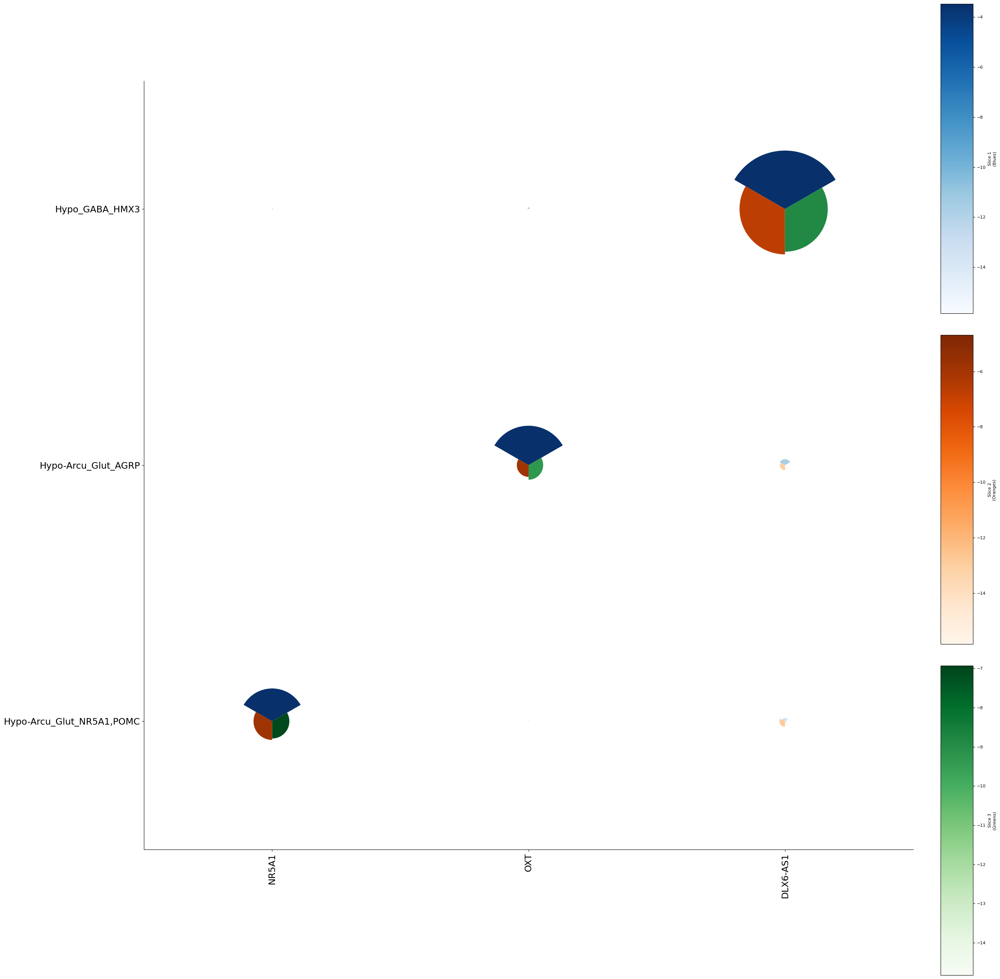

Immune


  0%|          | 0/1 [00:00<?, ?it/s]/home/matthew.schmitz/Matthew/utils/miniforge3/envs/rapids-24.12/lib/python3.12/site-packages/numpy/lib/_nanfunctions_impl.py:1633: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
100%|██████████| 1/1 [00:00<00:00, 904.72it/s]


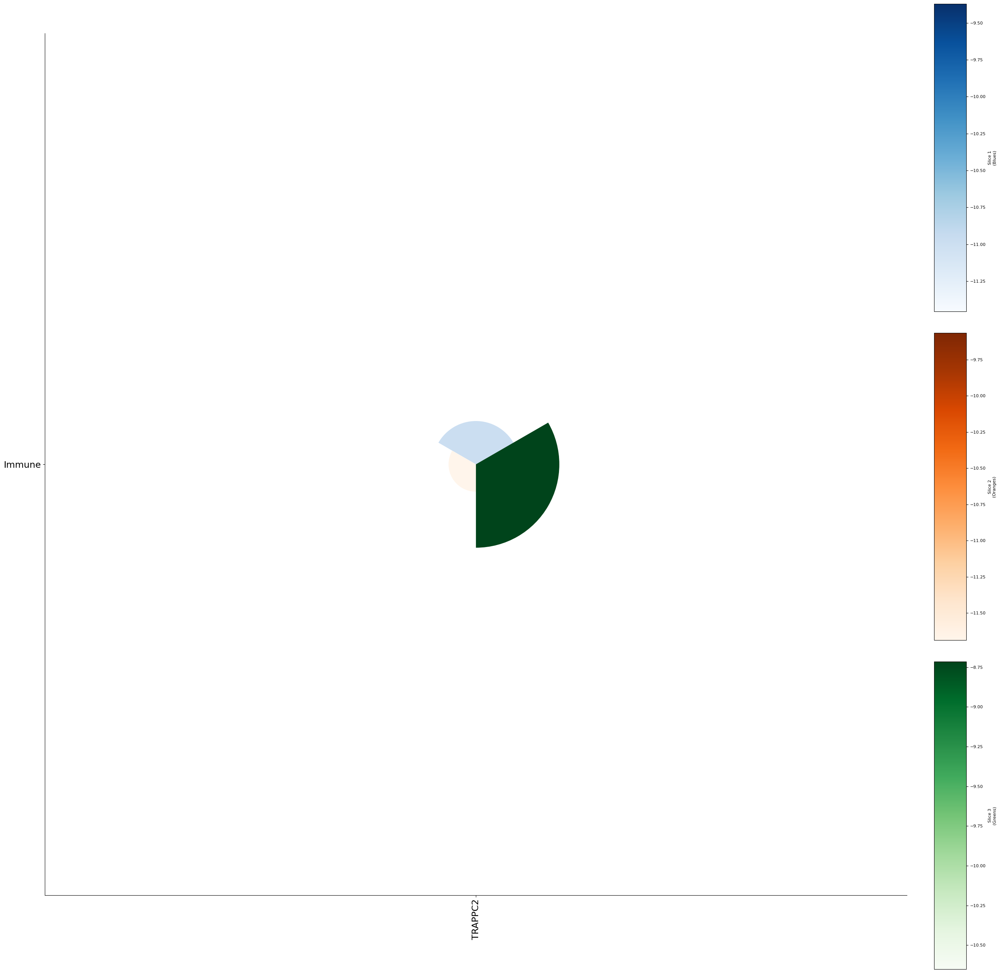

In [69]:
for c in set(class_order):
    print(c)
    cur_log_real_sc_means = log_real_sc_means[:,class_order==c,:]
    categories = adata.obs['Initial_Class_markers'].cat.categories[class_order==c]
    cur_aggr_sc_zeros = aggr_sc_zeros[0][:,class_order==c,:]
    clipped_expr_df = pd.DataFrame(cur_log_real_sc_means.mean(0),columns=adata.var.index,index=categories)
    coefdf = antipode.post.get_conserved_quantile_markers(cur_log_real_sc_means,columns=adata.var.index,index=categories, q=0.99,antimarker=False)
    selected_markers = antipode.post.select_marker_genes(
        coefdf, clipped_expr_df, marker=True,
        threshold=np.log(15/1e6))
    marker_gene_order=antipode.post.uniqlist([selected_markers.get(x,'AQP4') for x in categories])
    gene_order = np.array([np.where(adata.var.index == x) for x in marker_gene_order]).flatten()
    pie_dotplot([cur_log_real_sc_means[i,:,gene_order].T for i in range(cur_log_real_sc_means.shape[0])],
                [cur_aggr_sc_zeros[i,:,gene_order].T for i in range(cur_aggr_sc_zeros.shape[0])], 
                marker_gene_order, categories,
                scale_by='column', max_radius=0.4, figsize=(28, 28),fontsize_mul=1.7)
    plt.savefig(os.path.join(sc.settings.figdir, c+'_triple_conserved_Initial_Class_marker_dots.svg'), format='svg')
    plt.show()

In [ ]:
for c in set(neigh_order):
    print(c)
    cur_log_real_sc_means = log_real_sc_means[:,neigh_order==c,:]
    categories = adata.obs['Initial_Class_markers'].cat.categories[neigh_order==c]
    cur_aggr_sc_zeros = aggr_sc_zeros[0][:,neigh_order==c,:]
    clipped_expr_df = pd.DataFrame(cur_log_real_sc_means.mean(0),columns=adata.var.index,index=categories)
    coefdf = antipode.post.get_conserved_quantile_markers(cur_log_real_sc_means,columns=adata.var.index,index=categories, q=0.99,antimarker=False)
    selected_markers = antipode.post.select_marker_genes(
        coefdf, clipped_expr_df, marker=True,
        threshold=np.log(15/1e6))
    marker_gene_order=antipode.post.uniqlist([selected_markers.get(x,'AQP4') for x in categories])
    gene_order = np.array([np.where(adata.var.index == x) for x in marker_gene_order]).flatten()
    pie_dotplot([cur_log_real_sc_means[i,:,gene_order].T for i in range(cur_log_real_sc_means.shape[0])],
                [cur_aggr_sc_zeros[i,:,gene_order].T for i in range(cur_aggr_sc_zeros.shape[0])], 
                marker_gene_order, categories,
                scale_by='column', max_radius=0.4, figsize=(28, 28),fontsize_mul=1.7)
    plt.savefig(os.path.join(sc.settings.figdir, c+'_triple_conserved_Initial_Class_marker_dots_neigh.svg'), format='svg')
    plt.show()

# Gene Divisiones

In [ ]:
dfdafsdf

# Quick look at batch representation

In [ ]:
adata.var = pd.read_csv('/home/matthew.schmitz/Matthew/data/taxtest/gene_lists/var.csv',index_col=0)

In [ ]:
# #Propagate to get per-gene batch effects
batch_embeddings=antipode_model.be_nn(torch.eye(antipode_model.num_batch)).detach().cpu().numpy()
prop_batch_di = np.einsum('pc,dcm->dpm',prop_taxon[:,:pstore['batch_di'].shape[1]],pstore['batch_di'])
prop_batch_di = np.einsum('pc,cdg->pdg',batch_embeddings,prop_batch_di)
prop_batch_dm = np.einsum('pc,dcm->dpm',prop_taxon,pstore['batch_dm'])
print('Takes forever without gpu accel')
batch_cluster_params=np.einsum('dpm,mg->dpg',prop_batch_dm,pstore['z_decoder_weight'])+prop_batch_di
batch_mean=np.absolute(batch_cluster_params).mean(0,keepdims=True).mean(1,keepdims=True)*np.ones(centered_discov_cluster_params.shape)

In [ ]:
list(adata.var.index[batch_mean[0][0].argsort()])[-100:]

In [ ]:
list(adata.var.index[pstore['z_decoder_weight'].var(0).argsort()])[-100:]

In [ ]:
list(adata.var.index[pstore['s_inverse_dispersion'].argsort()])[:100]

In [ ]:
def distance_from_line(m, b, x, y):
    """Compute the distance from a line y = mx + b to points (x, y)."""
    numerator = np.abs((m * x) - y + b)
    denominator = np.sqrt(m**2 + 1)
    distances = numerator / denominator
    return distances

dfl=distance_from_line(slope, intercept,x=centered_discov_cluster_params,y=centered_aggr_means)
with seaborn.axes_style("whitegrid"):
    seaborn.scatterplot(x=centered_discov_cluster_params.flatten()[randinds],y=centered_aggr_means.flatten()[randinds],s=0.2,alpha=(dfl.flatten()[randinds]/dfl.flatten()[randinds].max()),color='black')
plt.show()

with seaborn.axes_style("whitegrid"):
    #seaborn.scatterplot(x=dfl,y=batch_mean.flatten()[randinds],s=0.2,color='black')
    seaborn.kdeplot(x=dfl.flatten()[randinds],y=batch_mean.flatten()[randinds],color='red',linestyles='--', linewidths=0.5)
    plt.xlabel('error')
    plt.ylabel('batch effect mean')



In [ ]:
with seaborn.axes_style("whitegrid"):
    seaborn.scatterplot(x=dfl.mean(0).mean(0),y=pstore['s_inverse_dispersion'],s=0.2,color='black')
    seaborn.kdeplot(x=dfl.mean(0).mean(0),y=pstore['s_inverse_dispersion'],color='red',linestyles='--', linewidths=0.5)
    plt.xlabel('error')
    plt.ylabel('theta')

In [ ]:
seaborn.scatterplot(x=pstore['z_decoder_weight'].var(0),y=batch_mean[0][0],s=0.5,color='black')
plt.xlabel('decoder weight var')
plt.ylabel('mean abs batch effect')

In [ ]:
# sc.pl.embedding(
#     adata,
#     basis='X_antipode_UMAP',
#     color=list(adata.var.index[pstore['s_inverse_dispersion'].argsort()])[:12],cmap='Purples',use_raw=False
# )

In [ ]:
# sc.pl.embedding(
#     adata,
#     basis='X_antipode_UMAP',
#     color=list(adata.var.index[dfl.mean(0).mean(0).argsort()])[-12:],cmap='Purples',use_raw=False
# )

In [ ]:
list(adata.var.index[dfl.mean(0).mean(0).argsort()])[-100:]

In [ ]:
#batch_mean=batch_mean/batch_mean.max()

In [ ]:
#batch_mean=(batch_mean>0.2).astype(float)

In [ ]:
batch_mean_inds=((-batch_mean).argsort(-1).argsort(-1)<10000).astype(float)
with seaborn.axes_style("whitegrid"):
    seaborn.scatterplot(x=discov_cluster_params.flatten()[randinds],y=centered_aggr_means.flatten()[randinds],s=0.2,color='black',alpha=batch_mean_inds.flatten()[randinds])
    plt.xlabel('reconstructed log mean cluster species LFC')
    plt.ylabel('actual mean cluster species LFC')

# Calculate the regression parameters
slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(discov_cluster_params.flatten(),centered_aggr_means.flatten())

# Plot the regression line
#x_values = np.linspace(np.min(discov_cluster_params.flatten()[randinds]), np.max(discov_cluster_params.flatten()[randinds]), 100)
#plt.plot(x_values, slope * x_values + intercept, color='red', label=f'y={slope:.2f}x+{intercept:.2f}, R²={r_value**2:.2f}')

# Add legend
#plt.legend()


In [ ]:
sdflksjdflkjsd

# Infer sex

In [ ]:
batch_aggr_means=antipode.model_functions.group_aggr_anndata(adata,[batch_key],layer=layer_key,normalize=True)
log_real_batch_means=np.log(batch_aggr_means[0]+1e-7)
batch_mean_df=pd.DataFrame(log_real_batch_means,index=adata.obs[batch_key].cat.categories,columns=adata.var.index)

In [ ]:
seaborn.histplot(log_real_batch_means.flatten())

In [ ]:
seaborn.histplot(batch_mean_df.loc[:,'XIST']-batch_mean_df.loc[:,'SRY'])
plt.ylabel('batch_name count')
plt.xlabel('log XIST - SRY')
plt.savefig(os.path.join(sc.settings.figdir,'xist-sry_heatmap.svg'))

In [ ]:
# pd.DataFrame((batch_mean_df.loc[:,'XIST']-batch_mean_df.loc[:,'SRY'])>5,columns=['female']).to_csv('/home/matthew.schmitz/Matthew/data/taxtest/extra/inferred_sex.csv')
# adata.obs['female']=adata.obs[batch_key].replace(pd.read_csv('/home/matthew.schmitz/Matthew/data/taxtest/extra/inferred_sex.csv',index_col=0).to_dict()['female'])
# seaborn.heatmap(adata.obs.groupby('individual')['female'].value_counts(normalize=True).unstack())

In [ ]:
sc.pl.embedding(
    adata,
    basis='X_antipode_MDE',
    color='female',cmap='Purples',use_raw=False
)

In [ ]:
seaborn.barplot(adata.obs.groupby([leaf_key])['psi_2'].std())

In [ ]:
seaborn.barplot(adata.obs.groupby([leaf_key])['psi_1'].std())

In [ ]:
adata.obs['psi_std_1']=adata.obs['level_1'].replace(adata.obs.groupby(['level_1'])['psi_1'].std().to_dict()).astype(float)

adata.obs['psi_std_2']=adata.obs[leaf_key].replace(adata.obs.groupby([leaf_key])['psi_2'].std().to_dict()).astype(float)

sc.pl.embedding(
    adata,
    basis='X_umap',
    color=['psi_std_1','psi_std_2'],cmap='Purples',use_raw=False
)